In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder

In [ ]:
file_link = 'https://drive.google.com/file/d/10_rkrsn_8obf1COdKa-YDwPNqzvXGyrJ/view?usp=drive_link'

id = file_link.split("/")[-2]
new_link = f'https://drive.google.com/uc?id={id}'
df = pd.read_csv(new_link)

df.head()
df.info()
print(df.shape)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28422 entries, 0 to 28421
Data columns (total 45 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Area Code        28422 non-null  int64  
 1   Area Code (M49)  28422 non-null  object 
 2   Area             28422 non-null  object 
 3   Item Code        28422 non-null  int64  
 4   Item Code (CPC)  28422 non-null  object 
 5   Item             28422 non-null  object 
 6   Element Code     28422 non-null  int64  
 7   Element          28422 non-null  object 
 8   Months Code      28422 non-null  int64  
 9   Months           28422 non-null  object 
 10  Unit             24546 non-null  object 
 11  Y1991            5147 non-null   float64
 12  Y1992            5270 non-null   float64
 13  Y1993            5895 non-null   float64
 14  Y1994            6311 non-null   float64
 15  Y1995            6752 non-null   float64
 16  Y1996            6969 non-null   float64
 17  Y1997       

In [ ]:
df.isnull().sum()

,0
Area Code,0
Area Code (M49),0
Area,0
Item Code,0
Item Code (CPC),0
Item,0
Element Code,0
Element,0
Months Code,0
Months,0


In [ ]:
df = df[df["Element"] == "Producer Price Index (2014-2016 = 100)"]

df = df.drop(columns=[
    "Area Code", "Area Code (M49)", "Item Code", "Item Code (CPC)",
    "Element Code", "Months Code", "Months", "Unit"
])

In [ ]:
print("Data Shape:", df.shape)
print("Unique Areas:", df["Area"].nunique())
print("Unique Items:", df["Item"].nunique())

Data Shape: (3876, 37)
Unique Areas: 45
Unique Items: 216


<ipython-input-11-6eaf2f6efa09>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=missing_counts.values, y=missing_counts.index, palette="viridis")


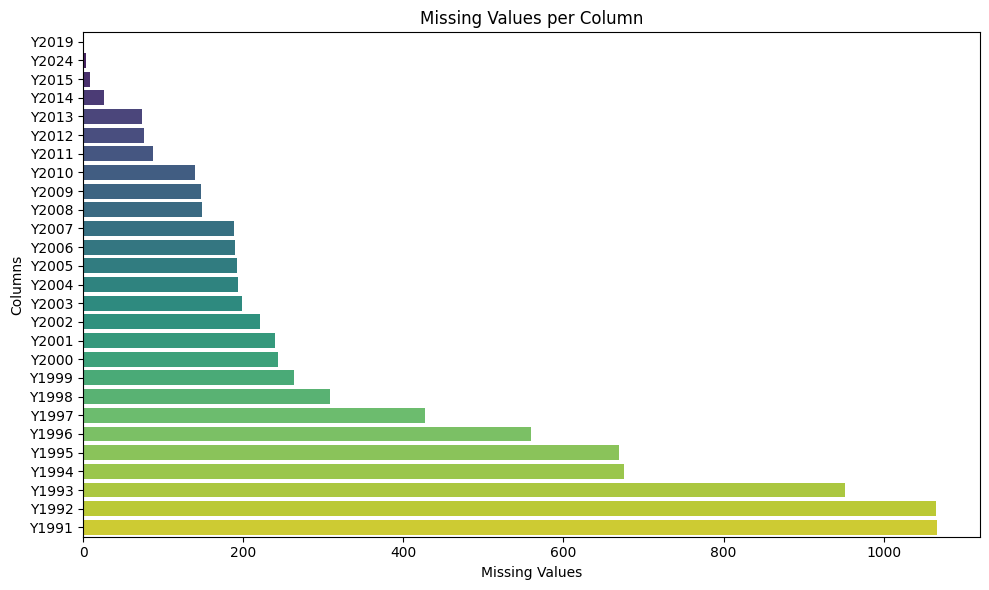

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

missing_counts = df.isnull().sum()
missing_counts = missing_counts[missing_counts > 0].sort_values()

plt.figure(figsize=(10, 6))
sns.barplot(x=missing_counts.values, y=missing_counts.index, palette="viridis")
plt.xlabel("Missing Values")
plt.ylabel("Columns")
plt.title("Missing Values per Column")
plt.tight_layout()
plt.show()

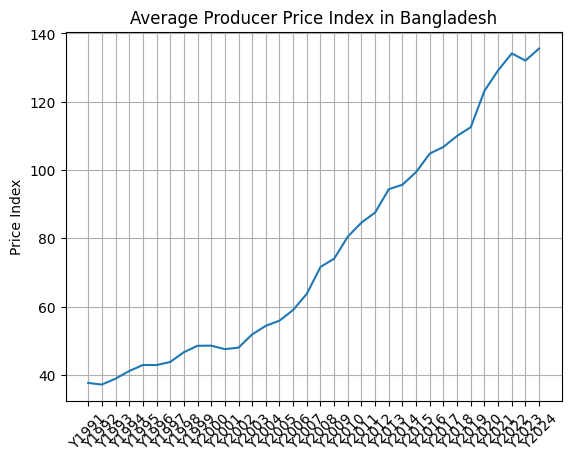

In [ ]:
sample = df[df["Area"] == "Bangladesh"]
sample_years = [col for col in sample.columns if col.startswith("Y")]
plt.plot(sample_years, sample[sample_years].mean())
plt.xticks(rotation=45)
plt.title("Average Producer Price Index in Bangladesh")
plt.ylabel("Price Index")
plt.grid(True)
plt.show()


In [ ]:
df.isnull().sum()

,0
Area,0
Item,0
Element,0
Y1991,1067
Y1992,1066
Y1993,952
Y1994,676
Y1995,669
Y1996,559
Y1997,427


In [ ]:
year_cols = [col for col in df.columns if col.startswith("Y")]
id_cols = ["Area", "Item", "Element"]

df_grouped = df.groupby(id_cols)[year_cols].mean().reset_index()
df_grouped[year_cols] = df_grouped[year_cols].interpolate(axis=1, limit_direction="both")

df_grouped = df_grouped[df_grouped[year_cols].notnull().sum(axis=1) >= 10].reset_index(drop=True)

In [ ]:
df_long = df_grouped.melt(
    id_vars=["Area", "Item", "Element"],
    value_vars=year_cols,
    var_name="Year",
    value_name="Value"
)

# Remove the "Y" prefix and convert to integer year
df_long["Year"] = df_long["Year"].str[1:].astype(int)


<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


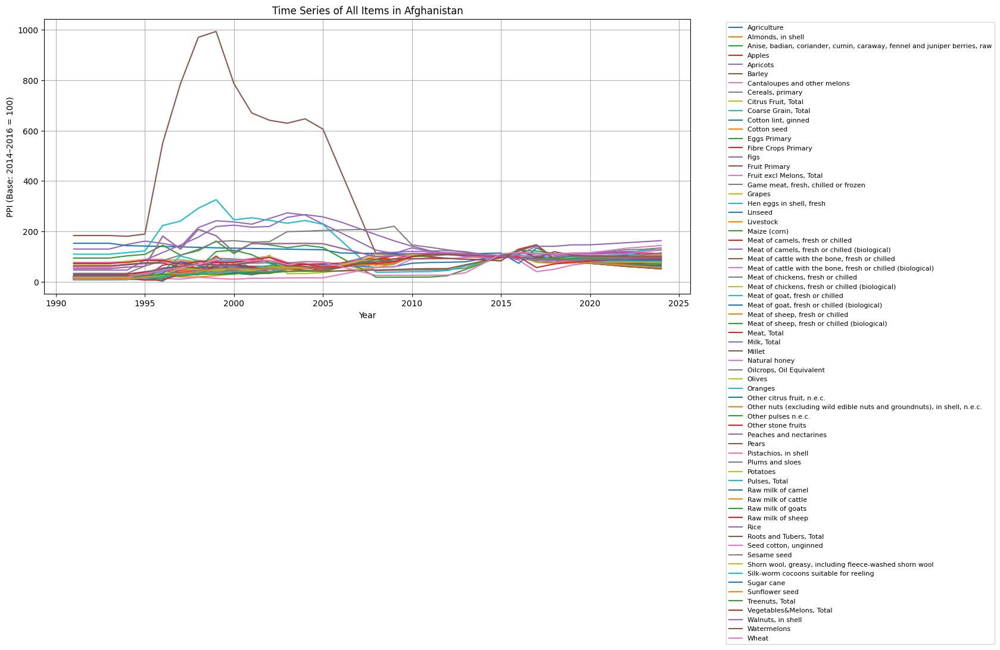

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


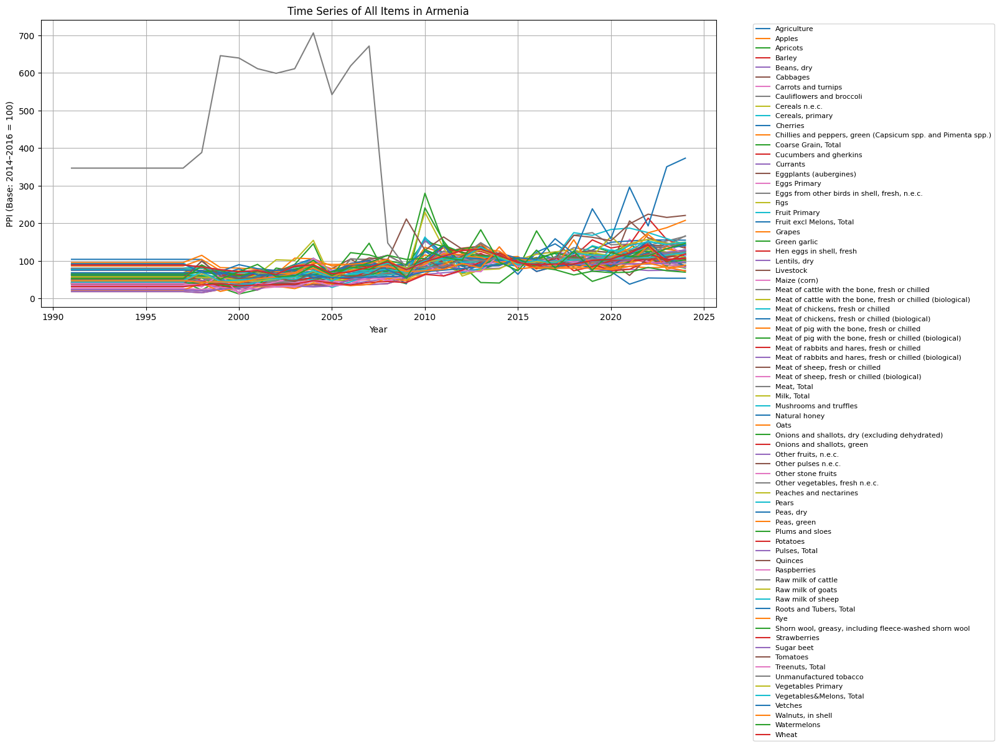

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


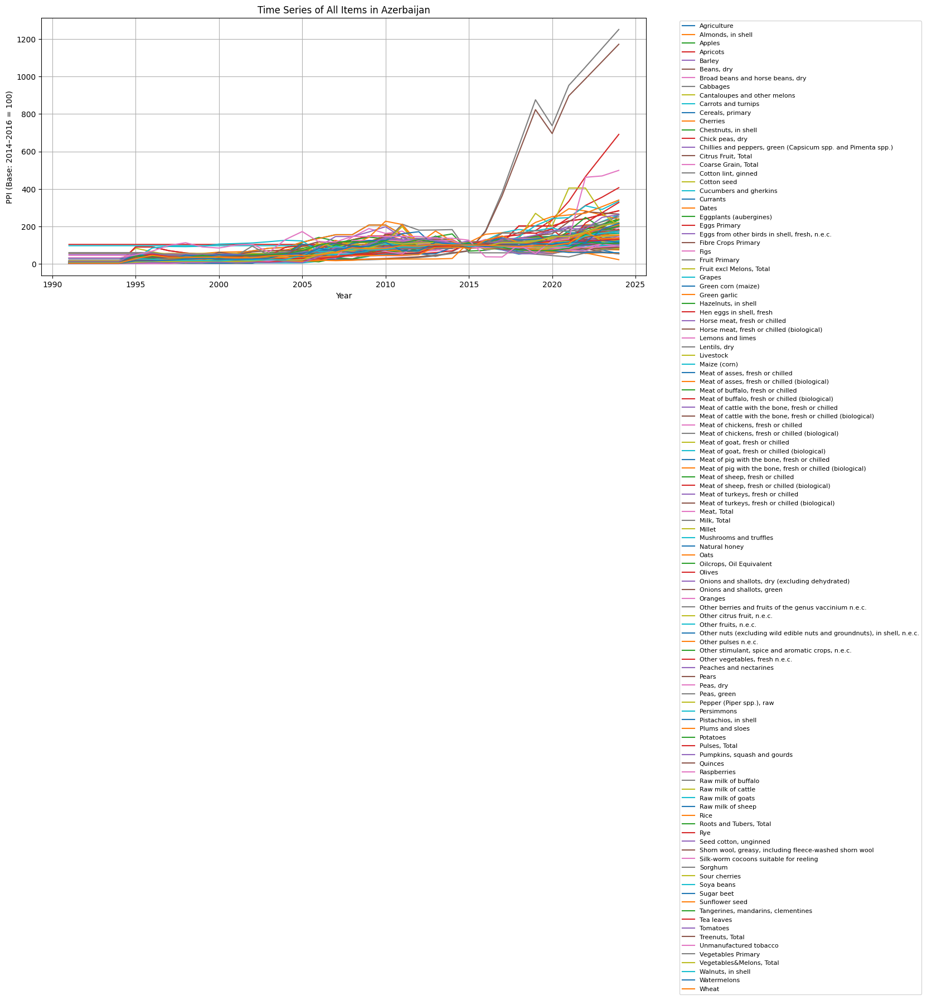

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


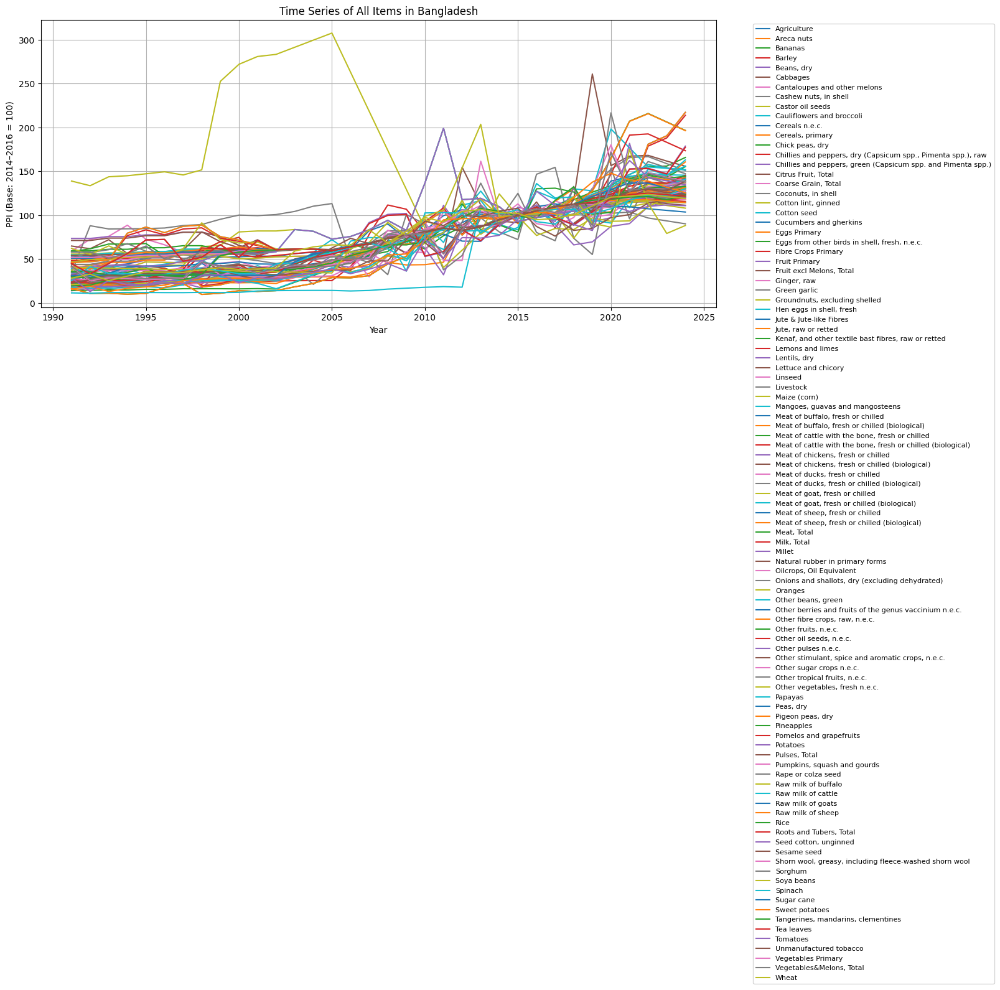

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


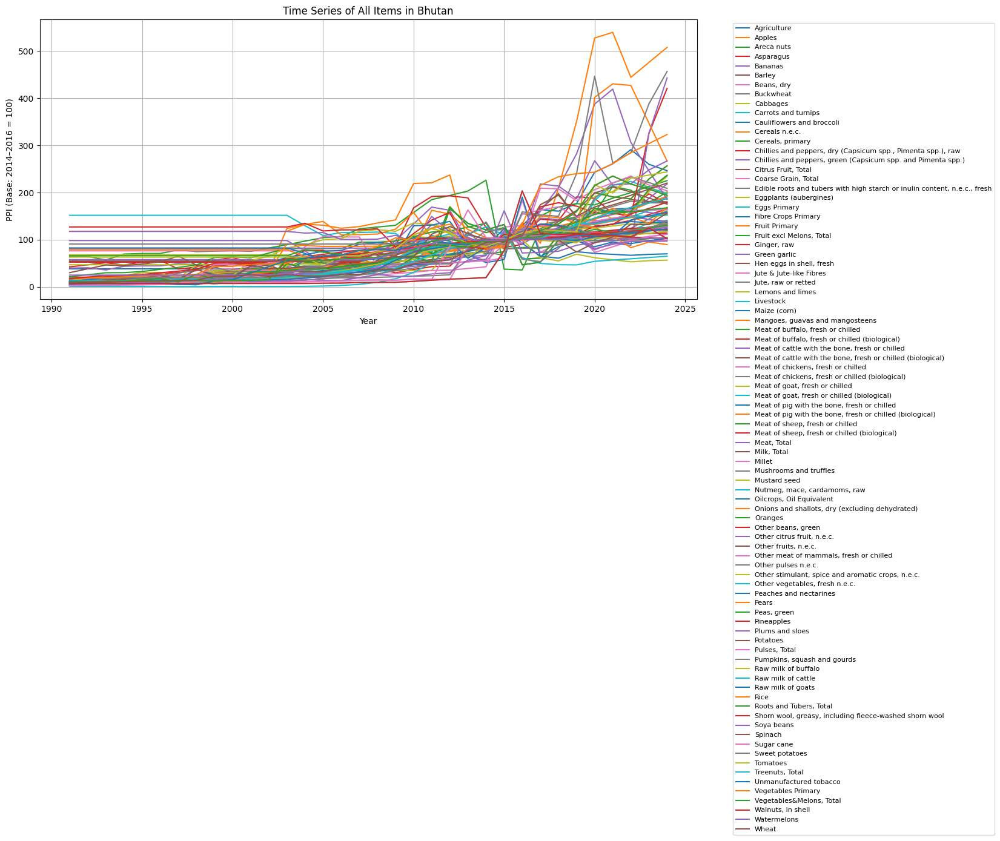

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


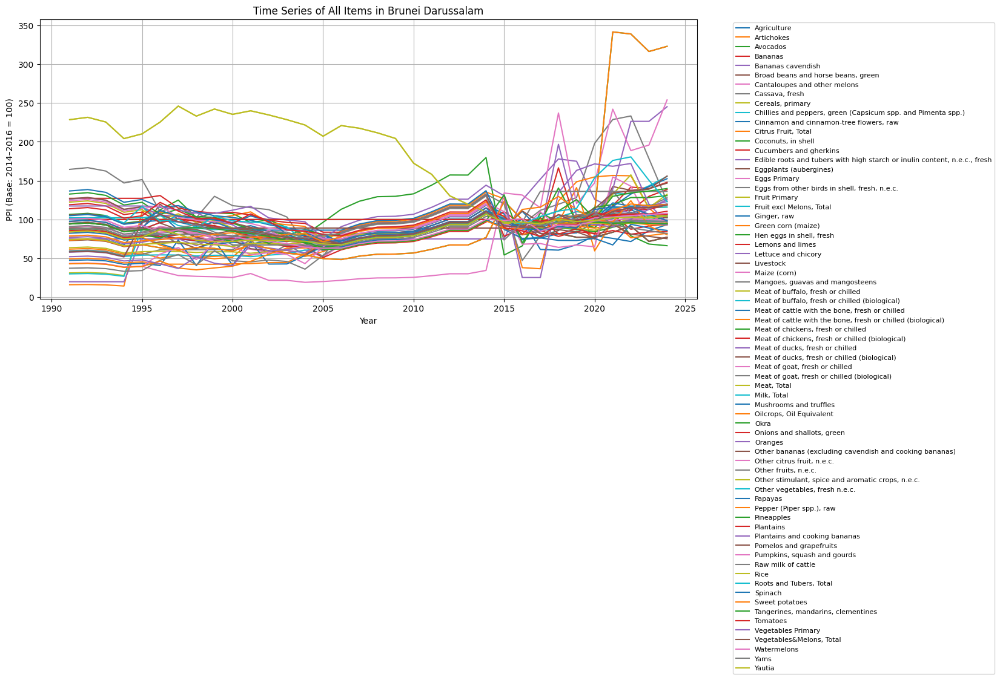

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


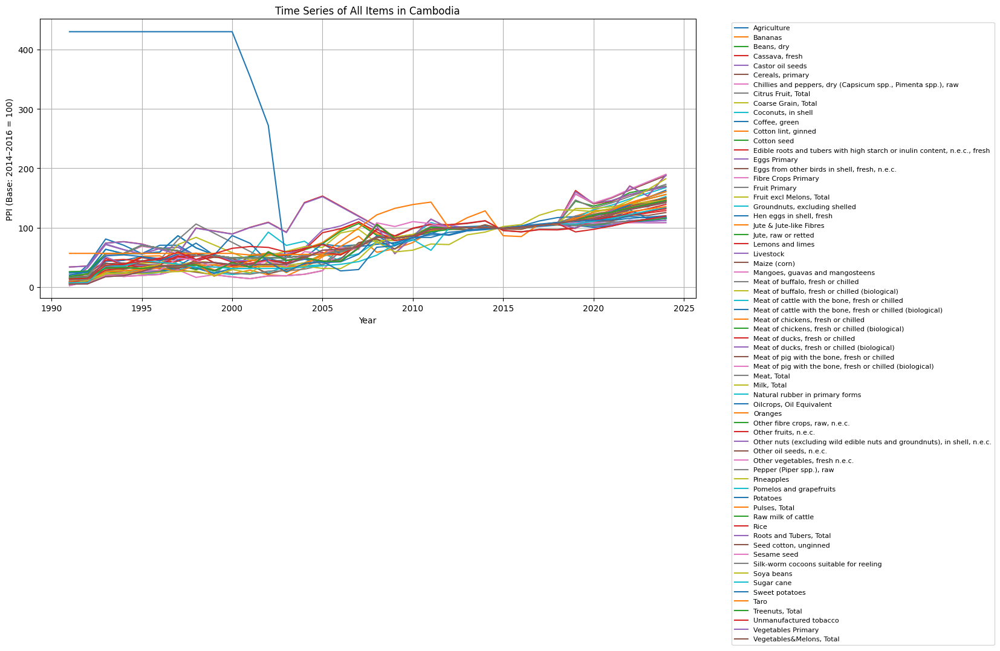

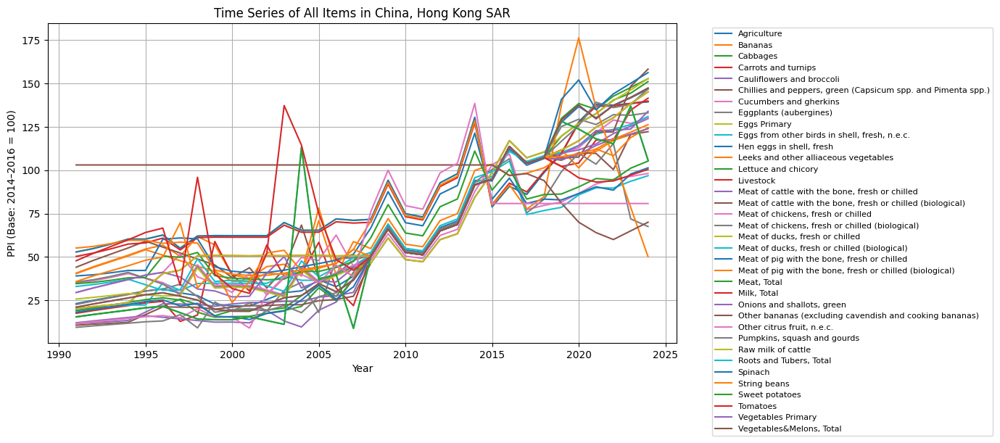

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


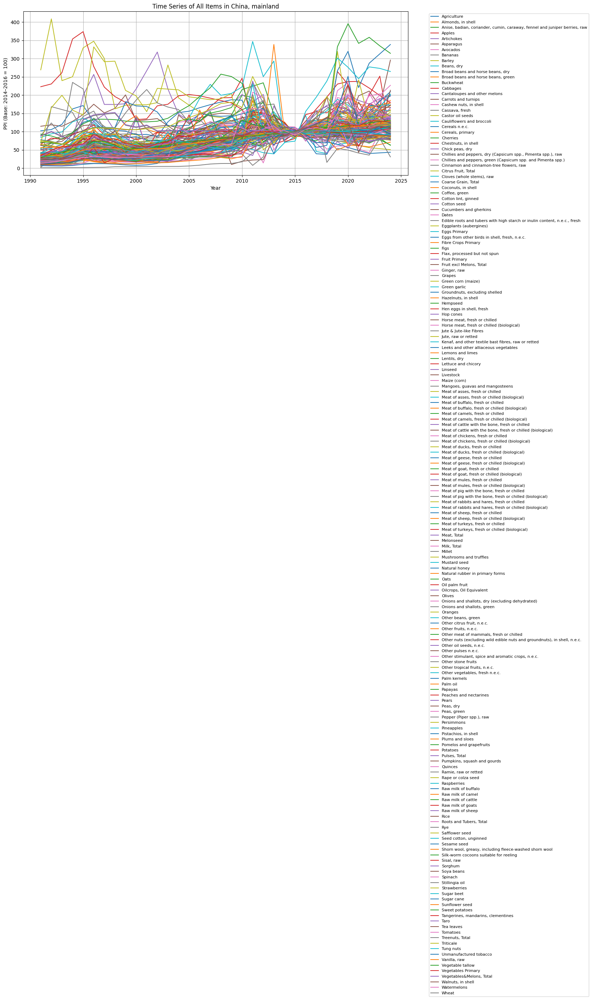

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


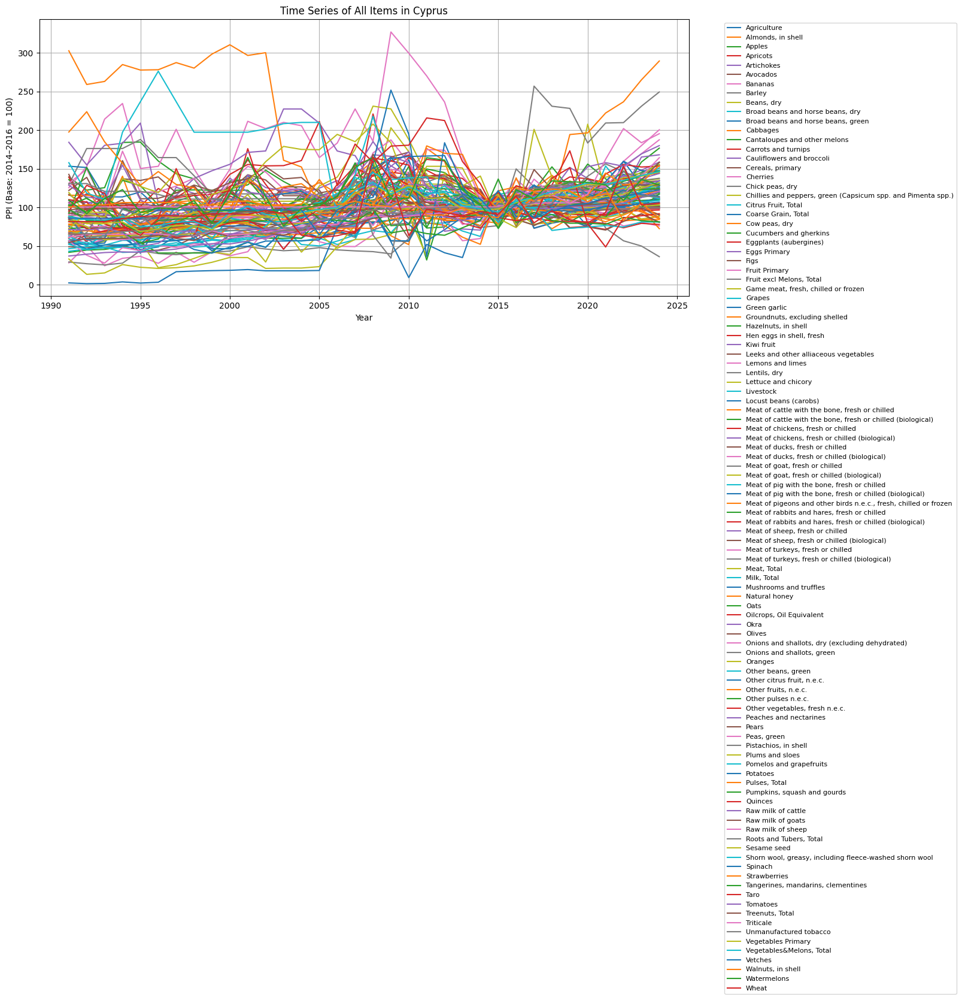

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


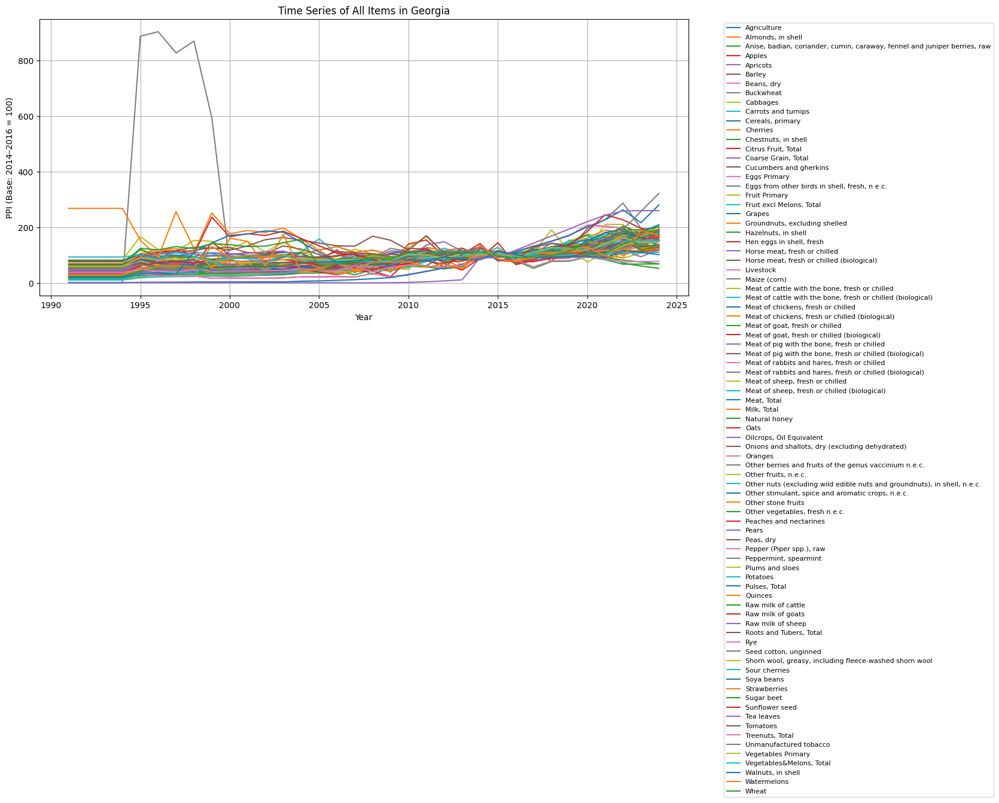

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


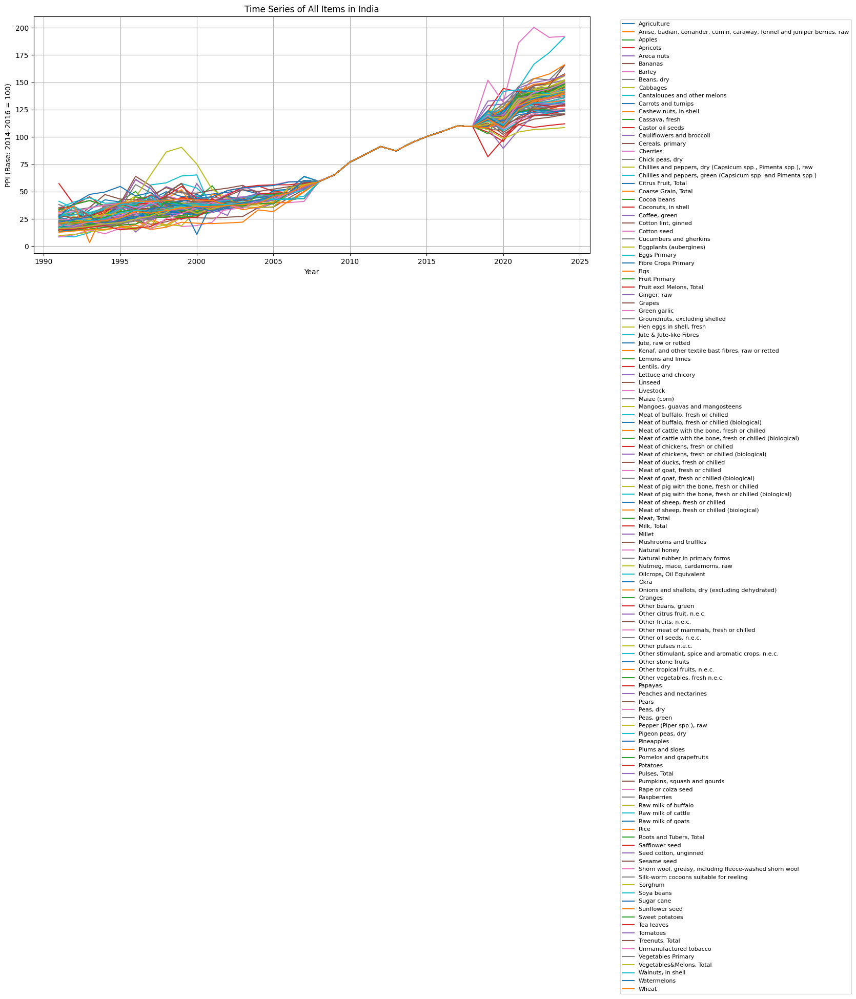

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


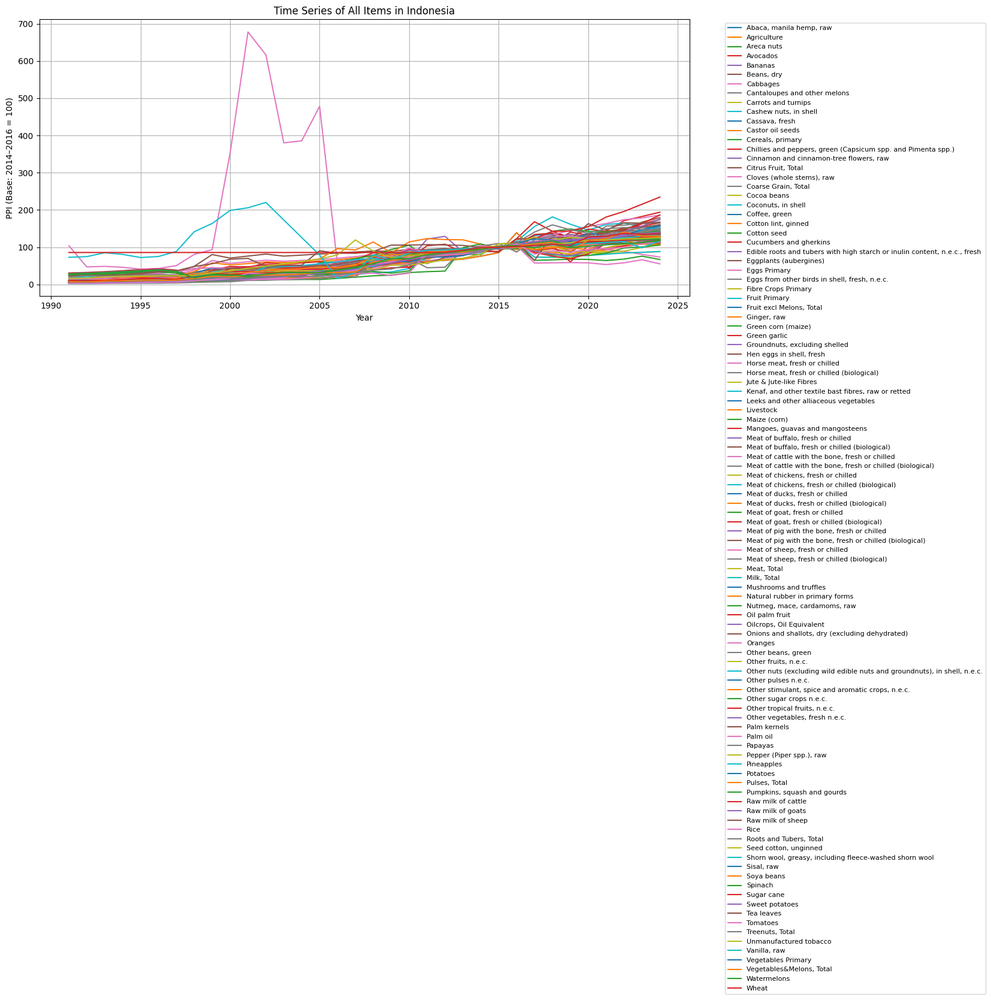

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


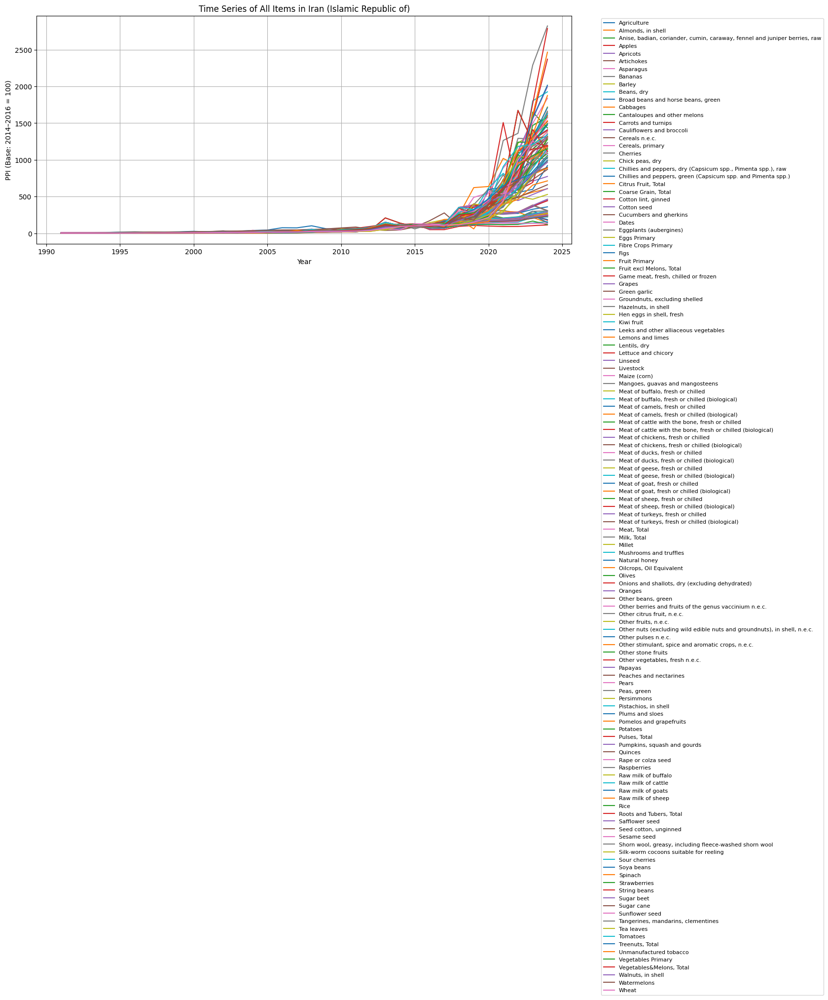

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


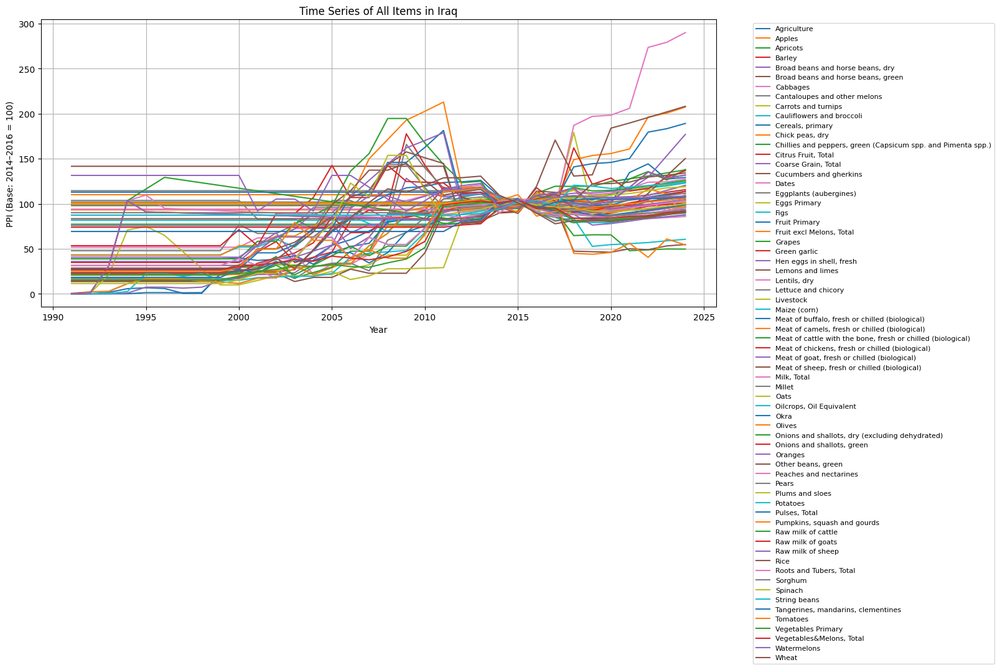

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


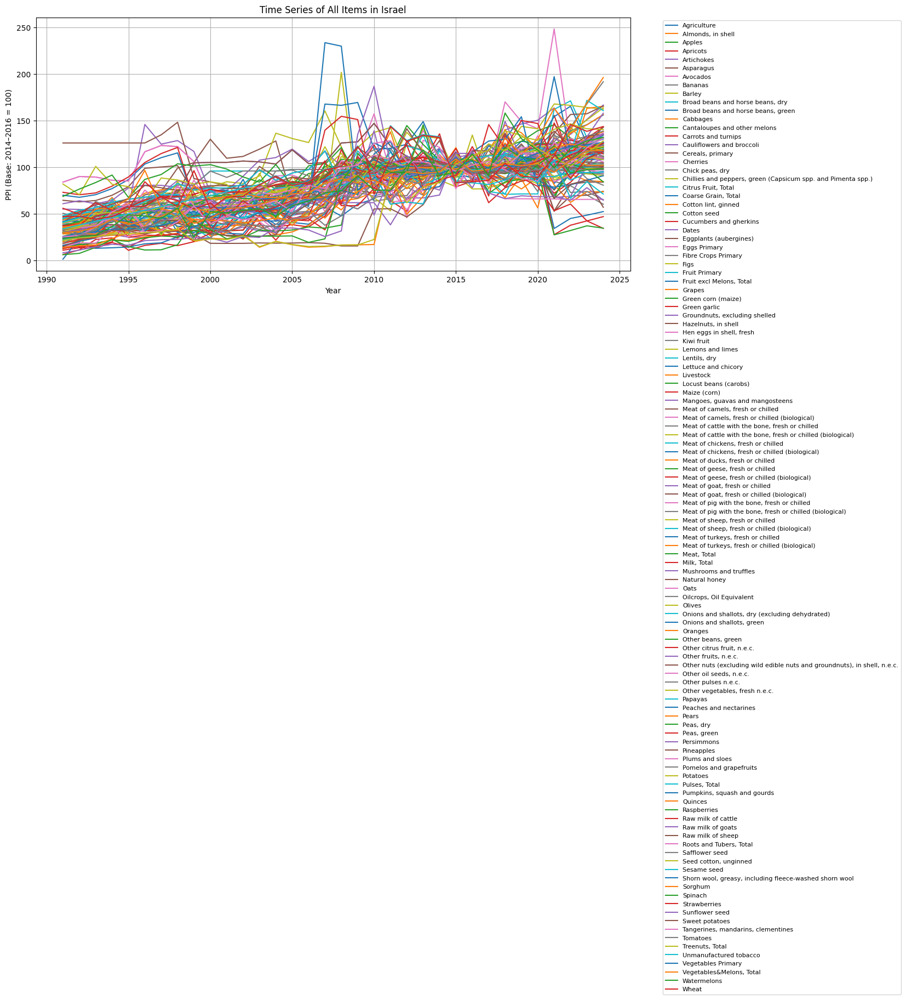

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


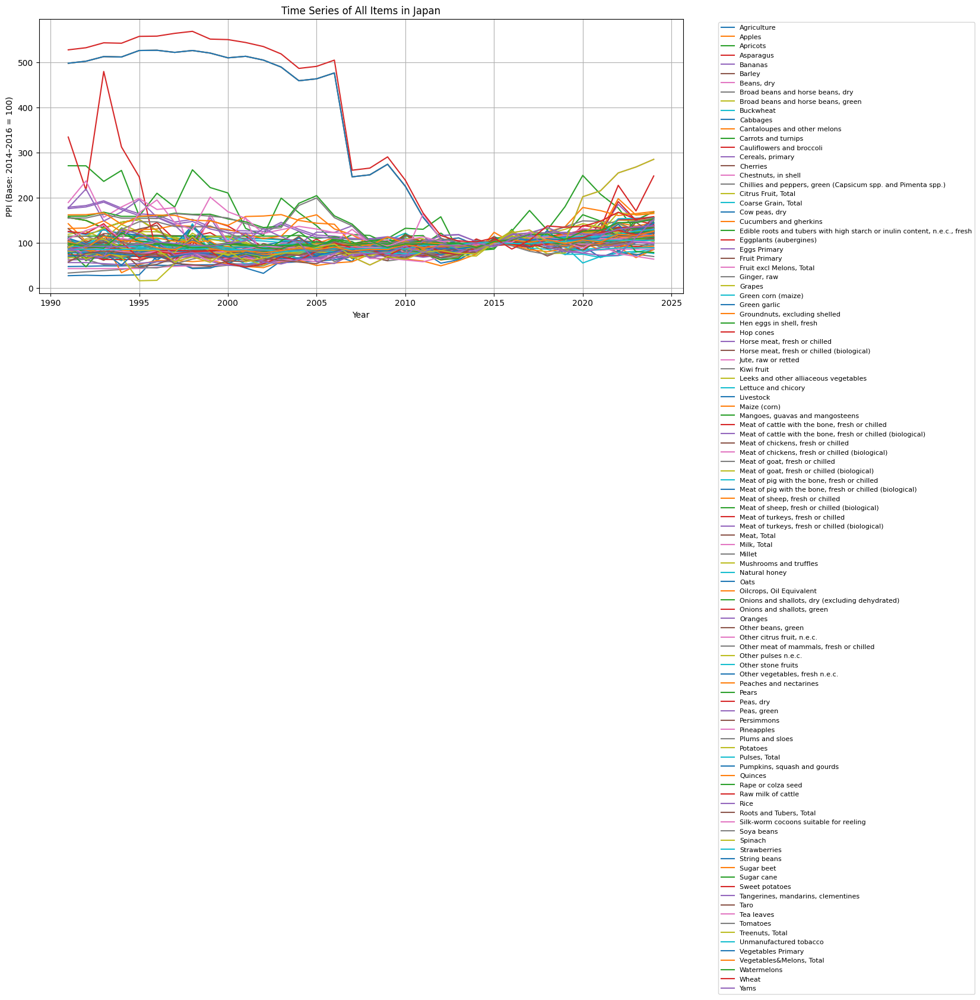

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


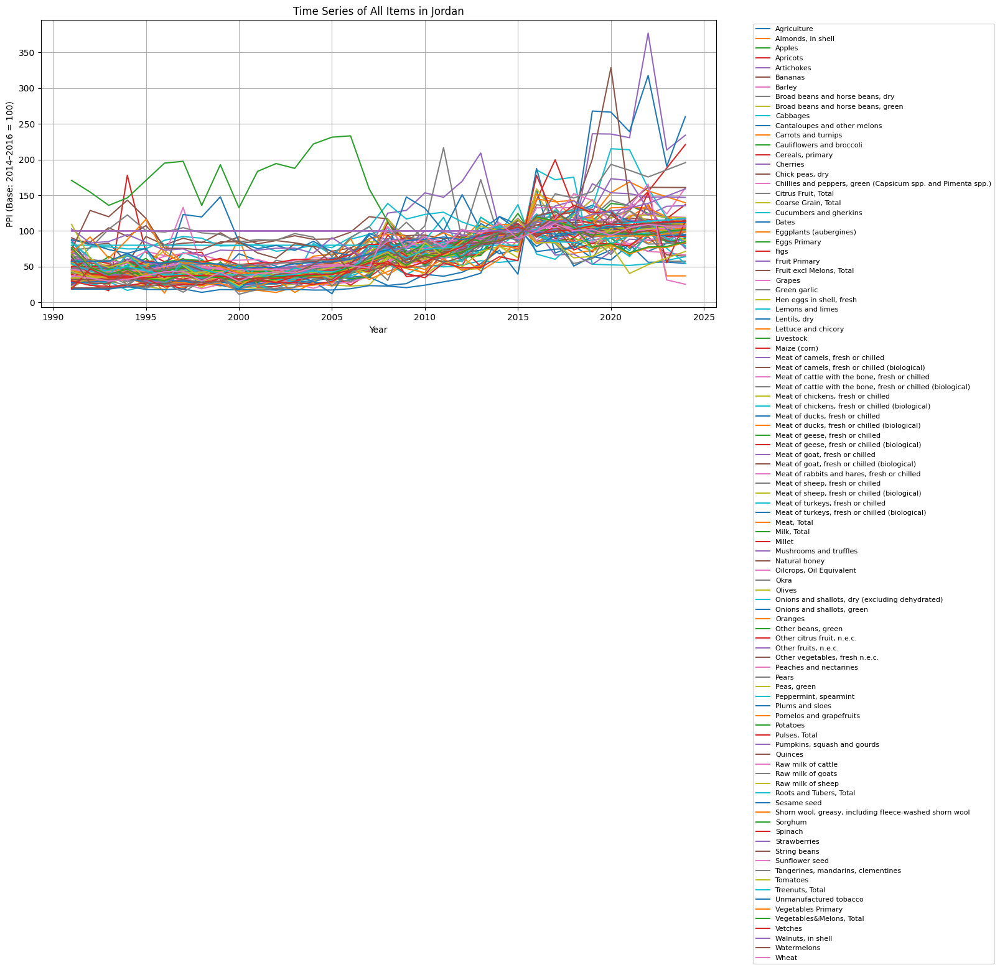

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


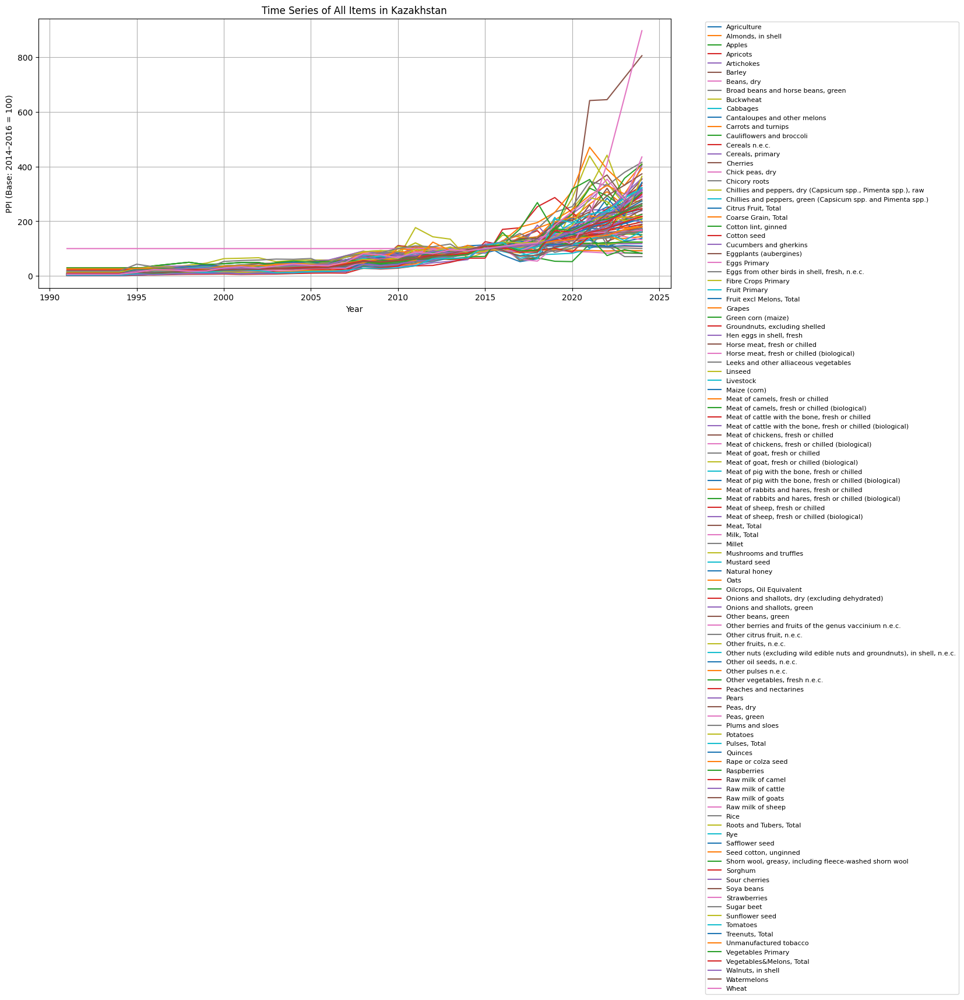

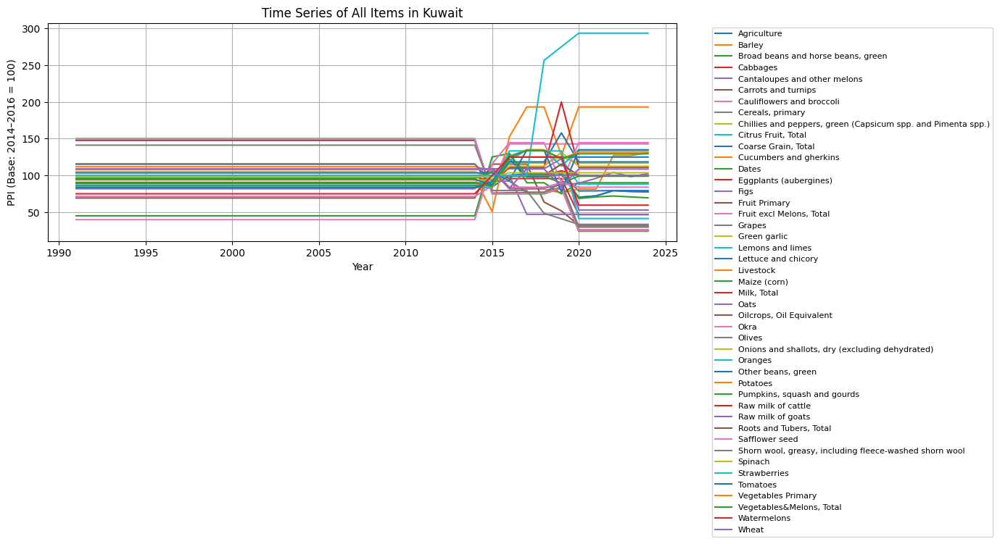

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


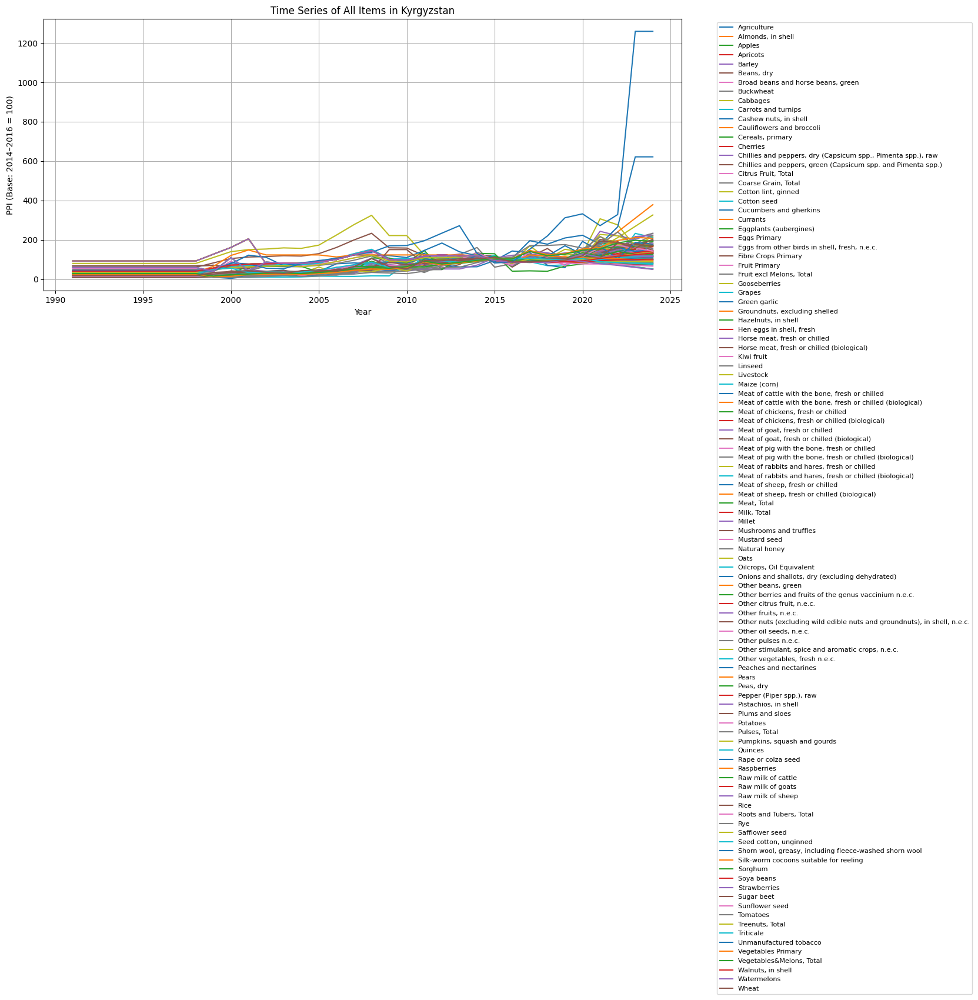

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


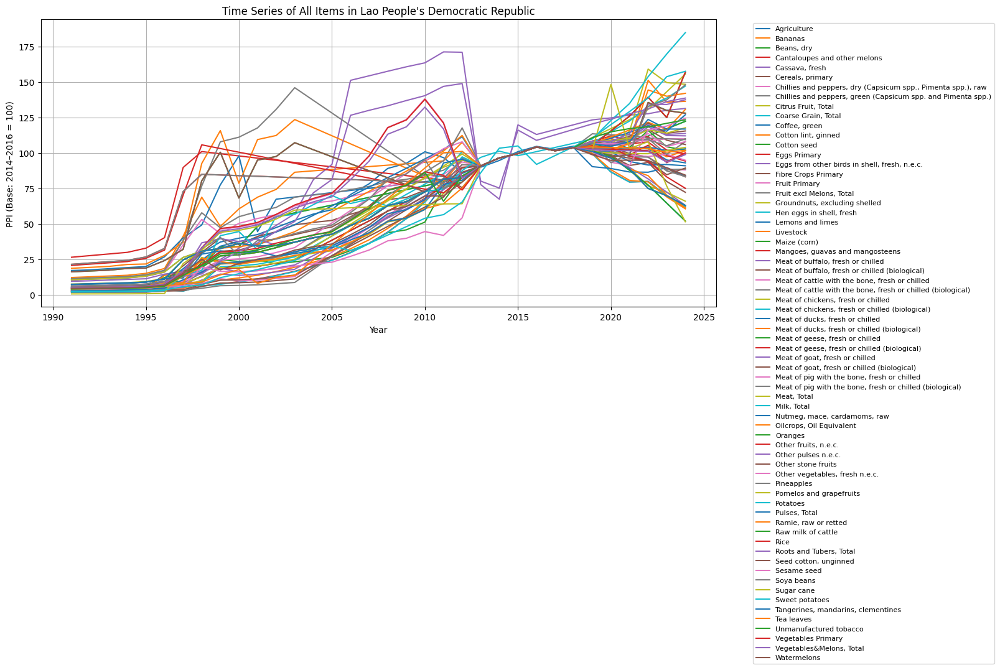

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


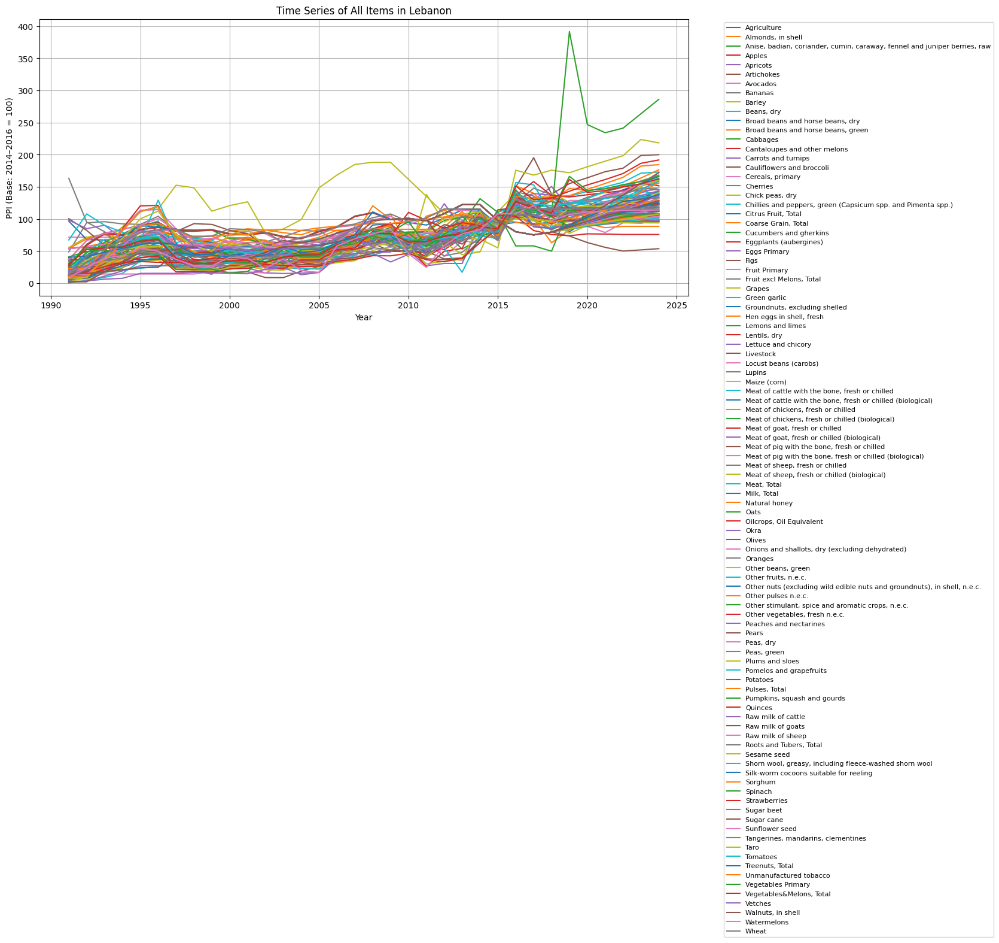

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


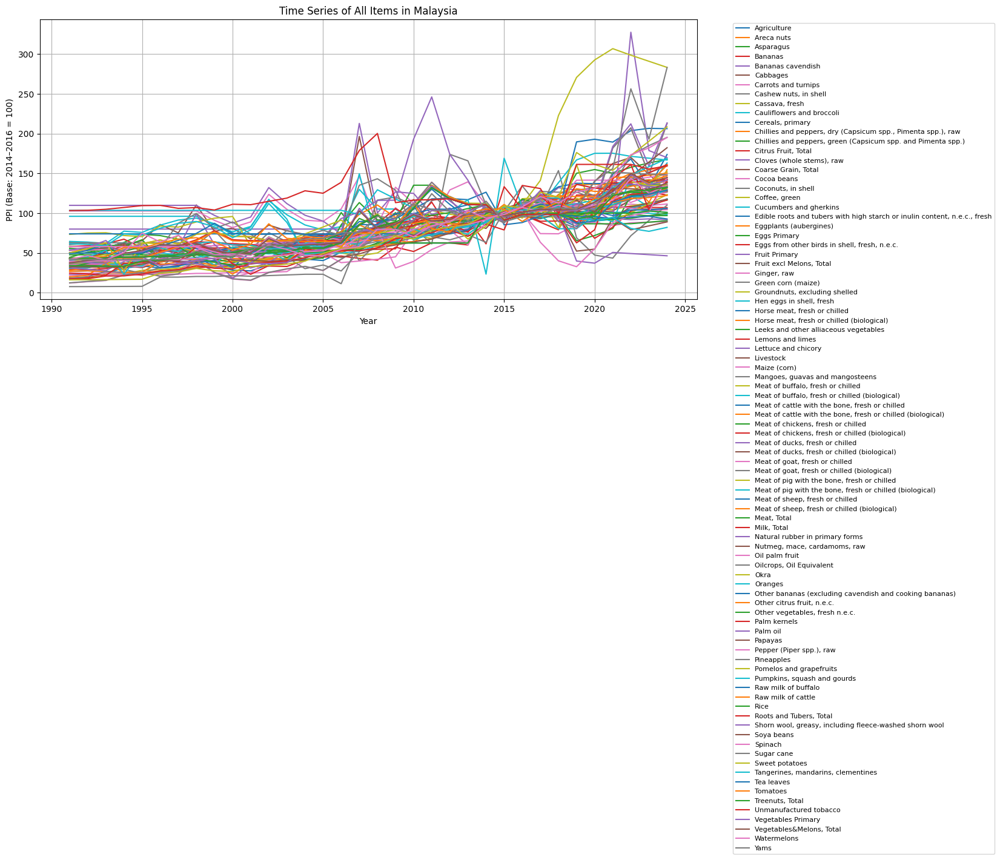

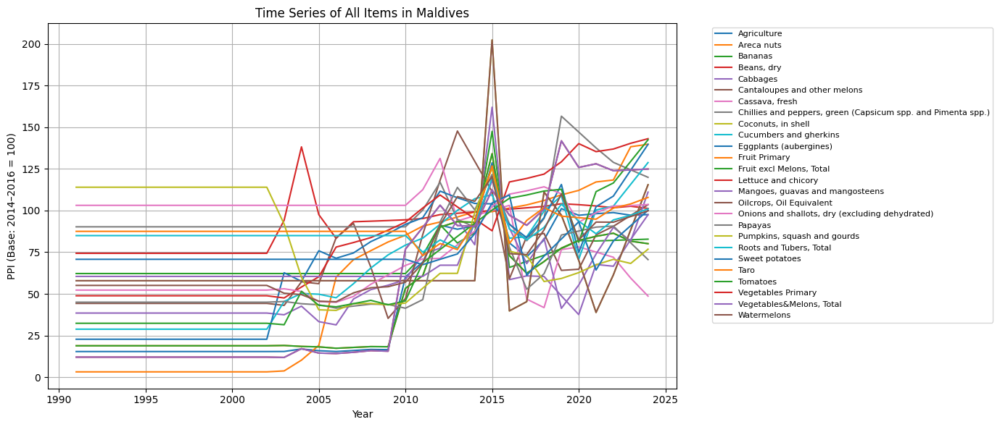

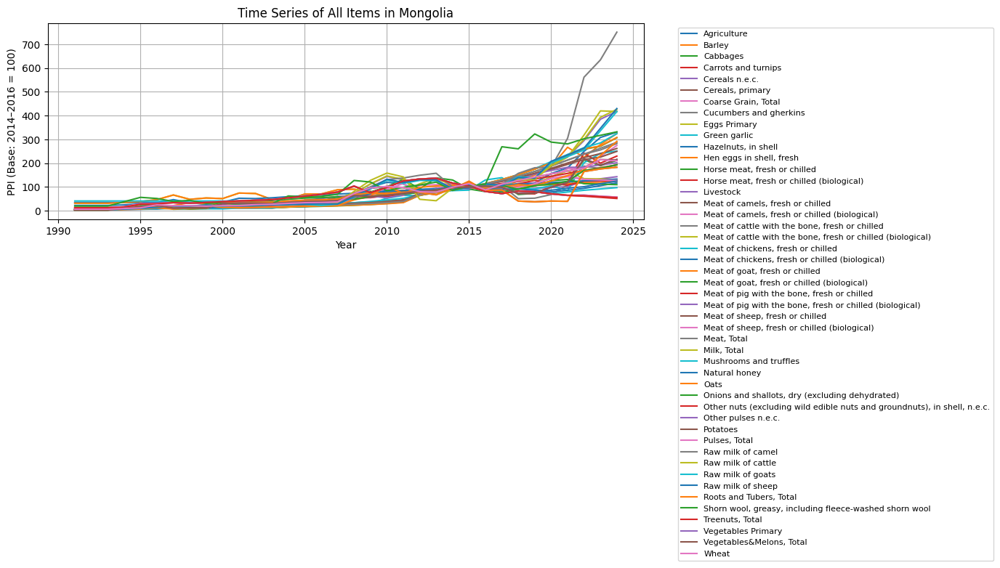

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


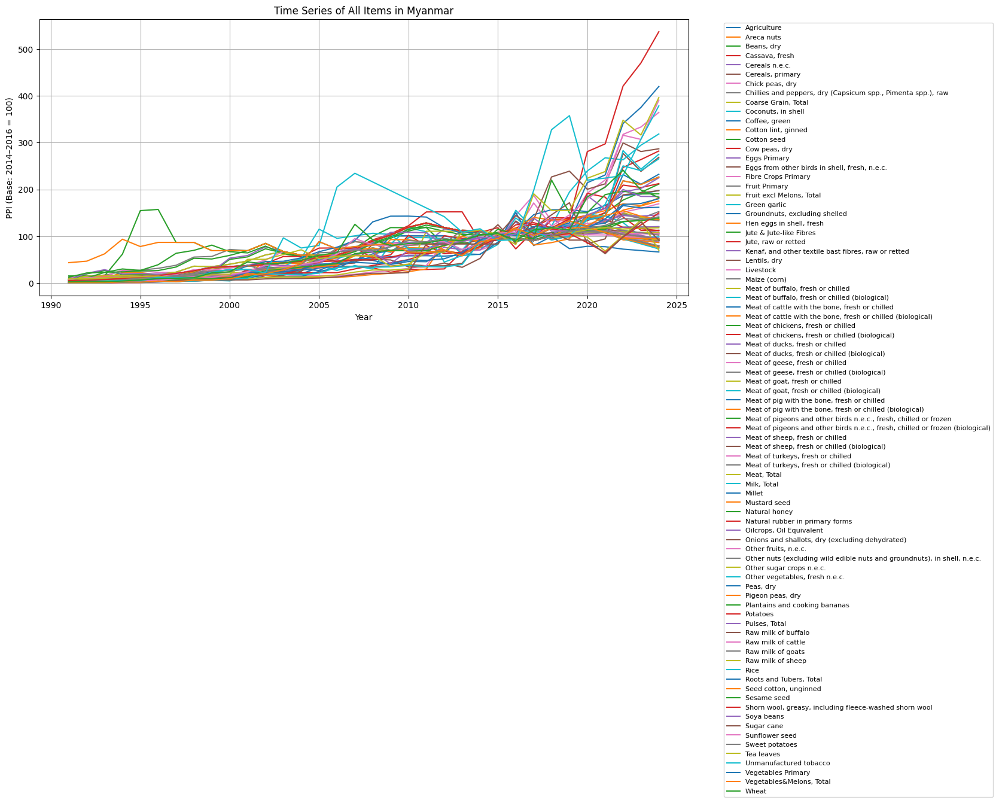

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


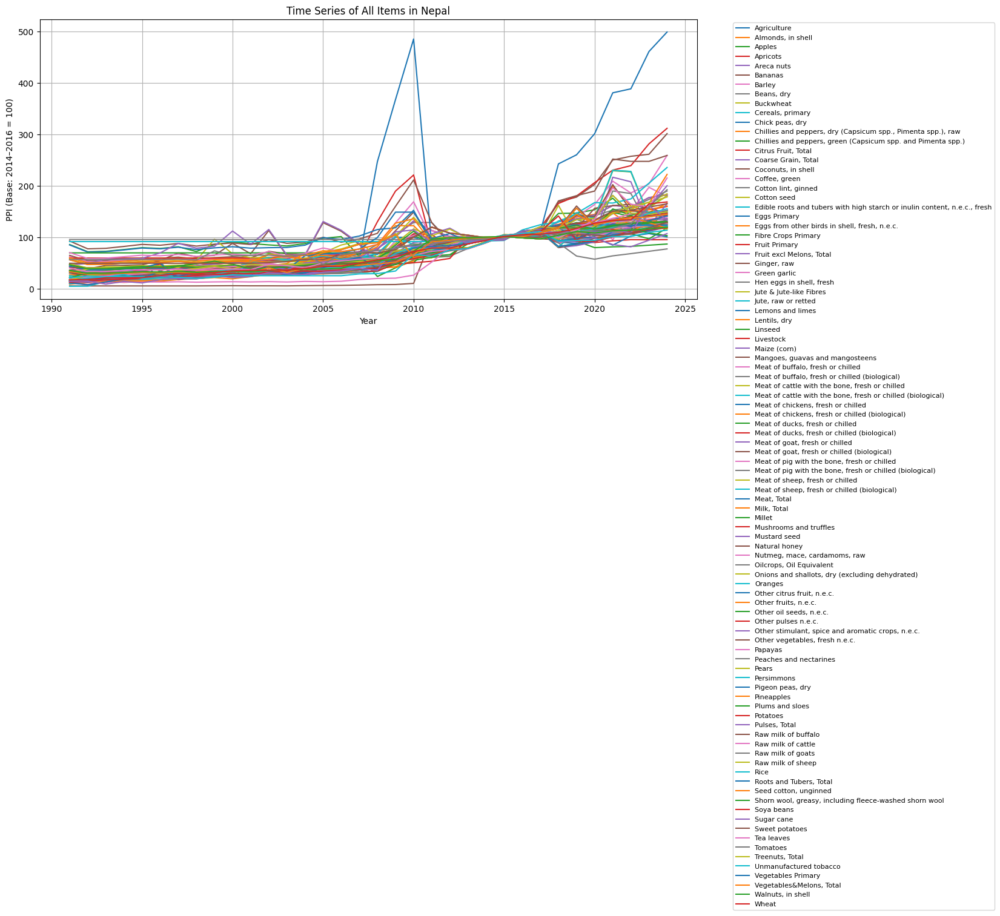

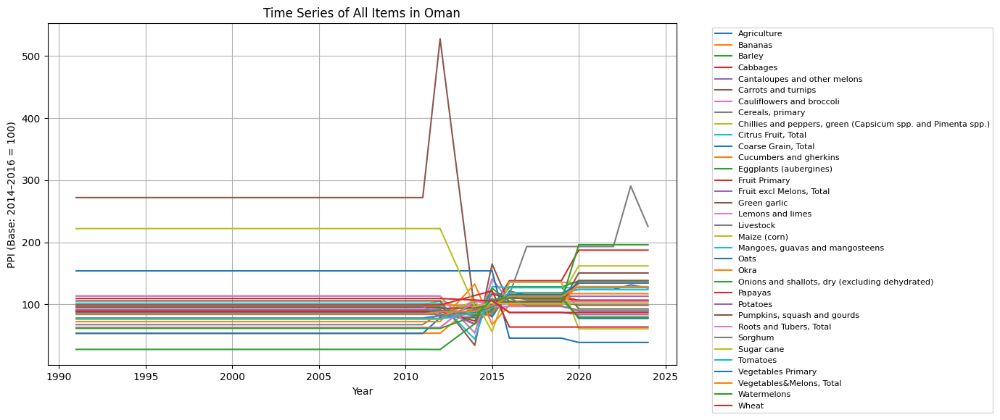

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


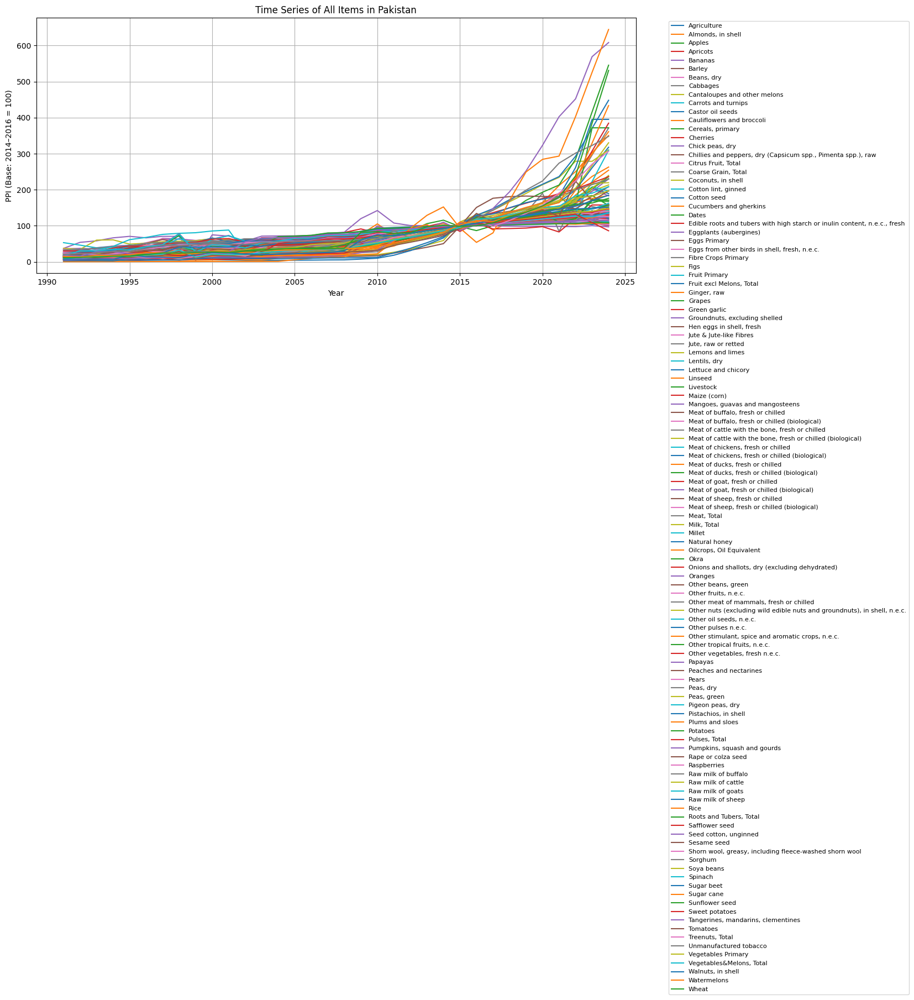

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


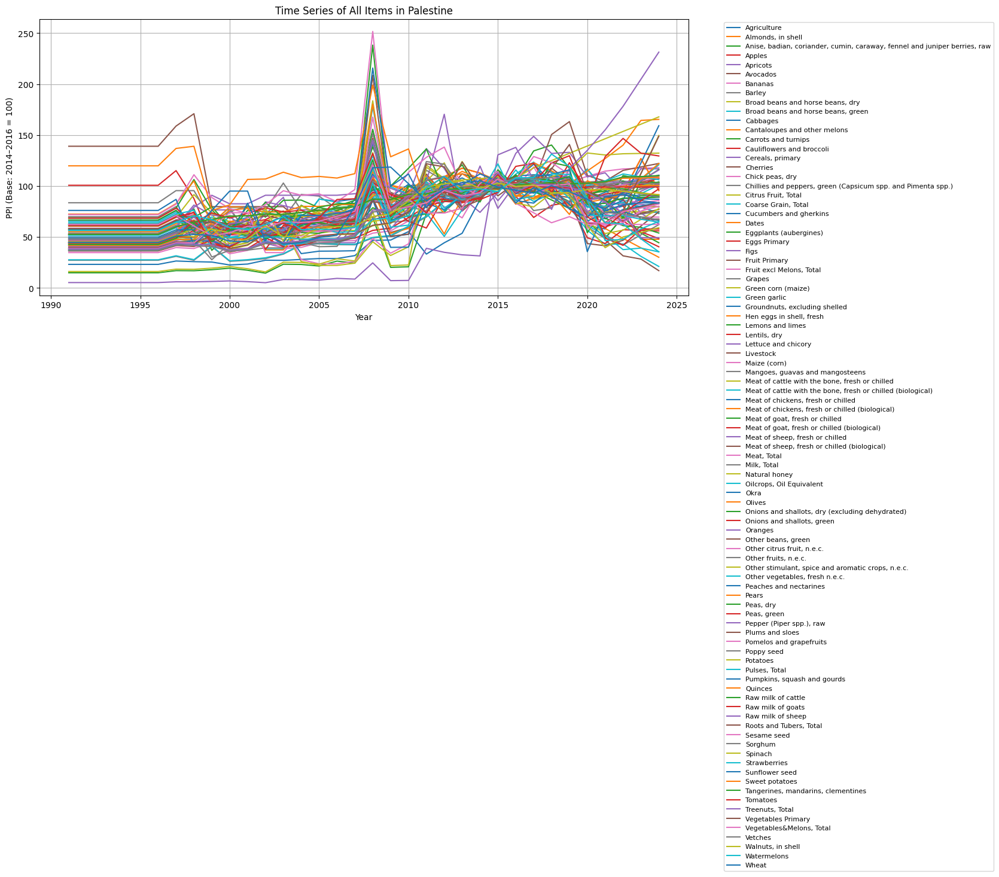

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


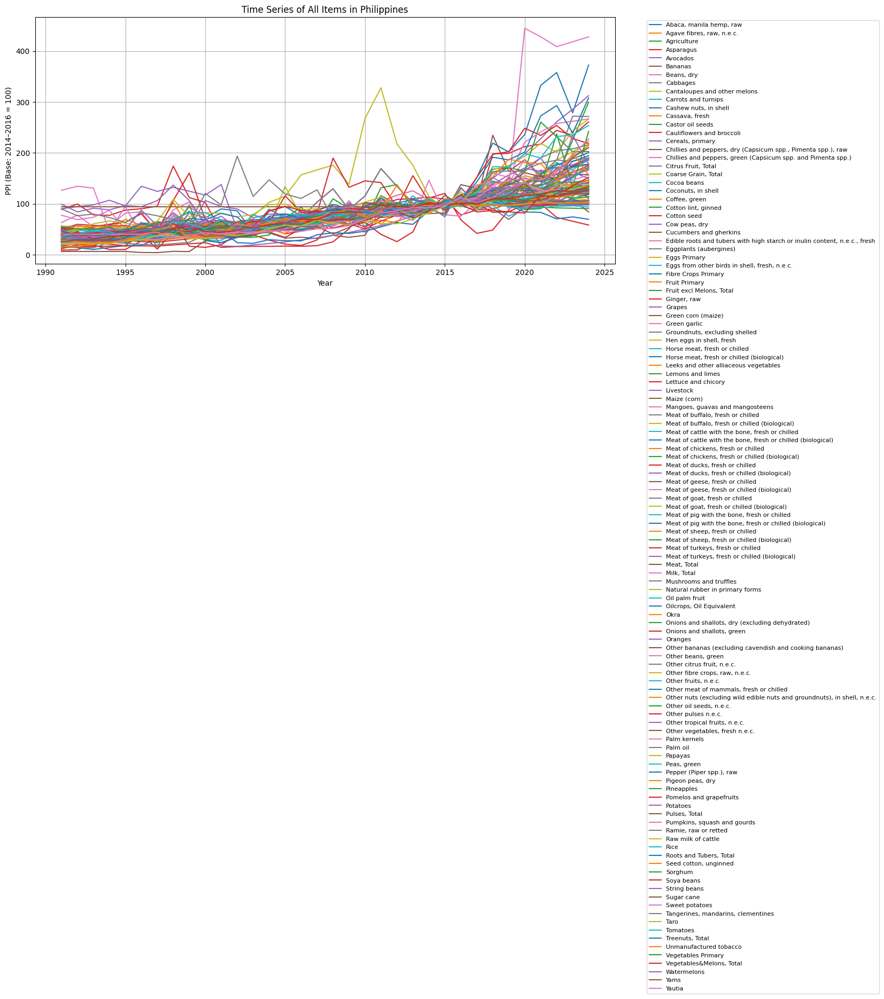

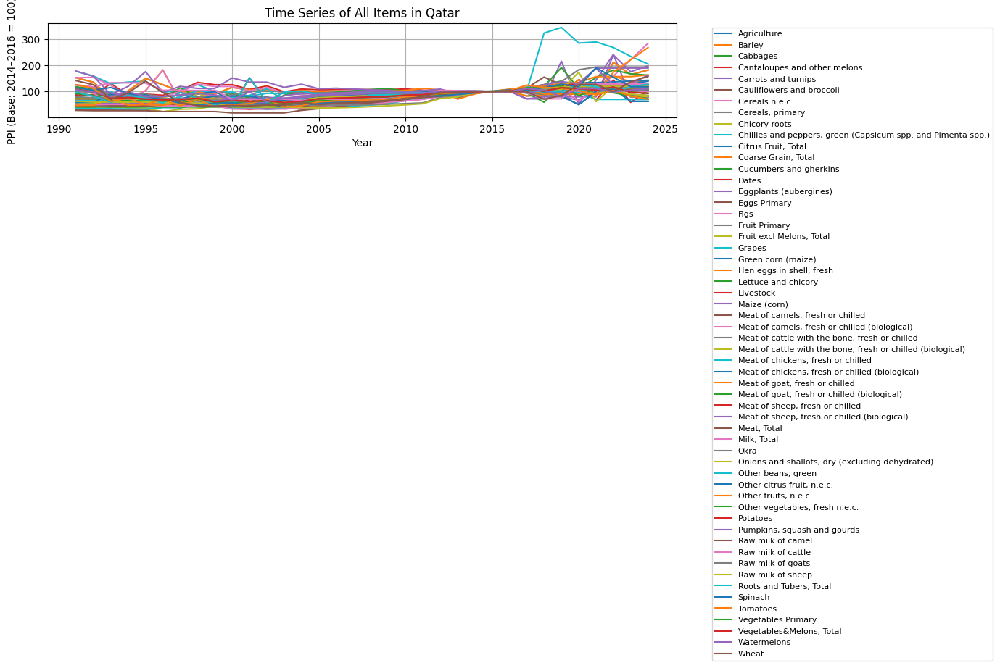

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


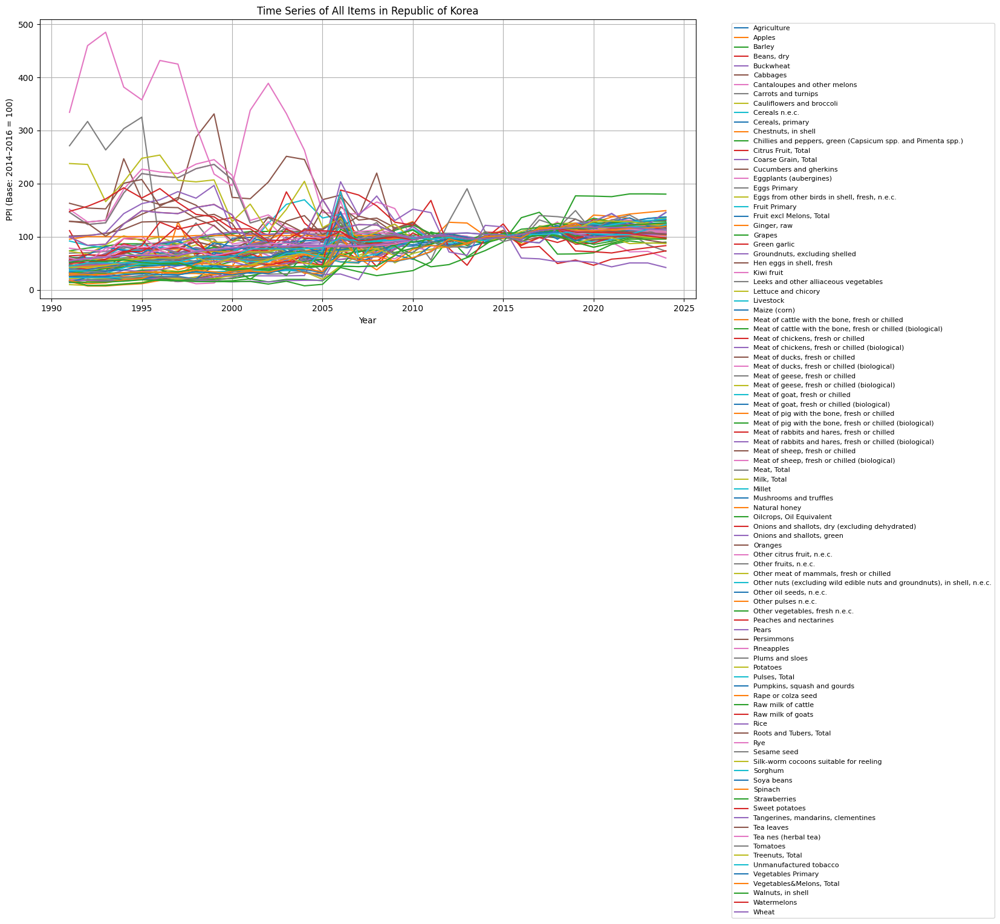

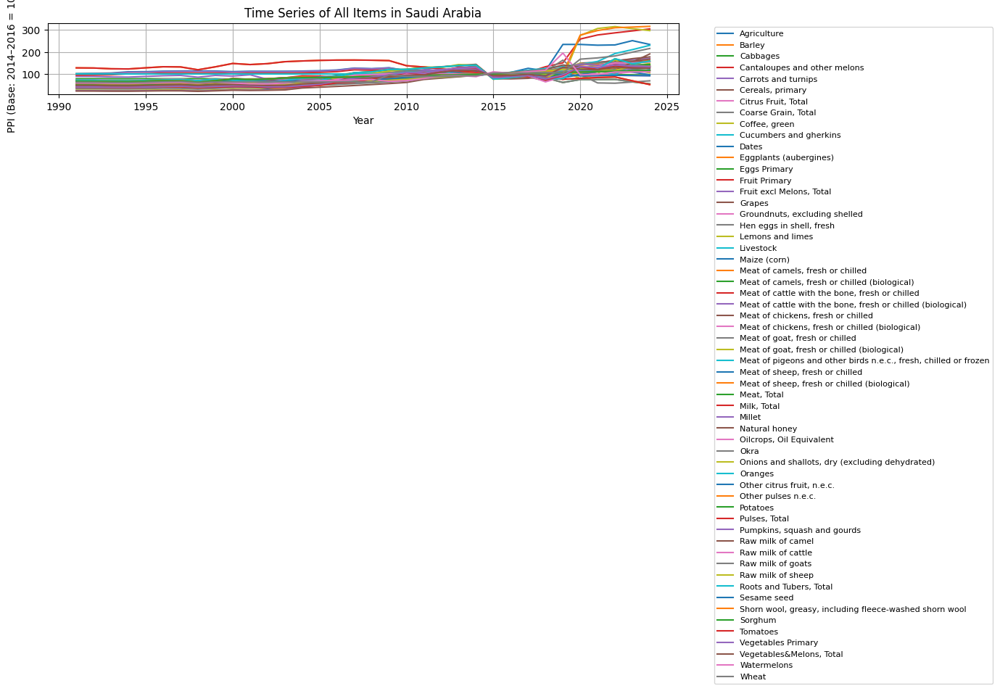

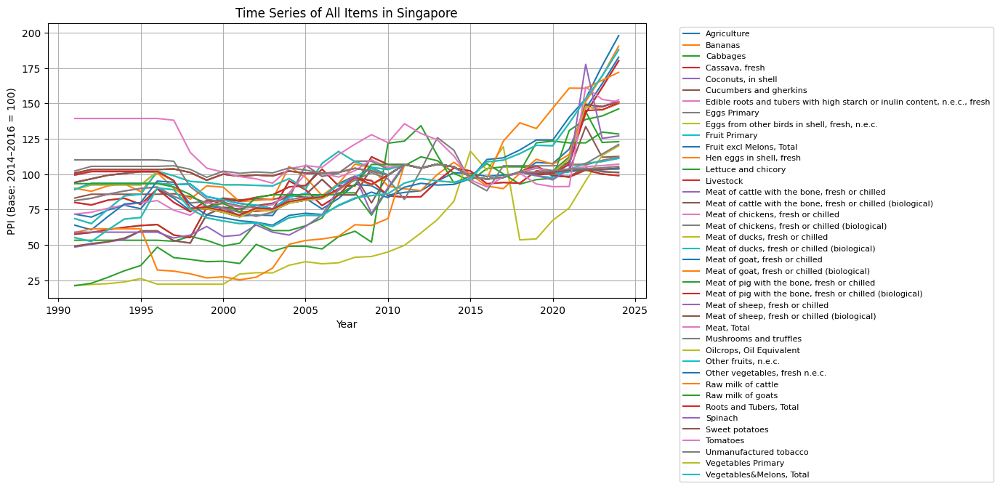

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


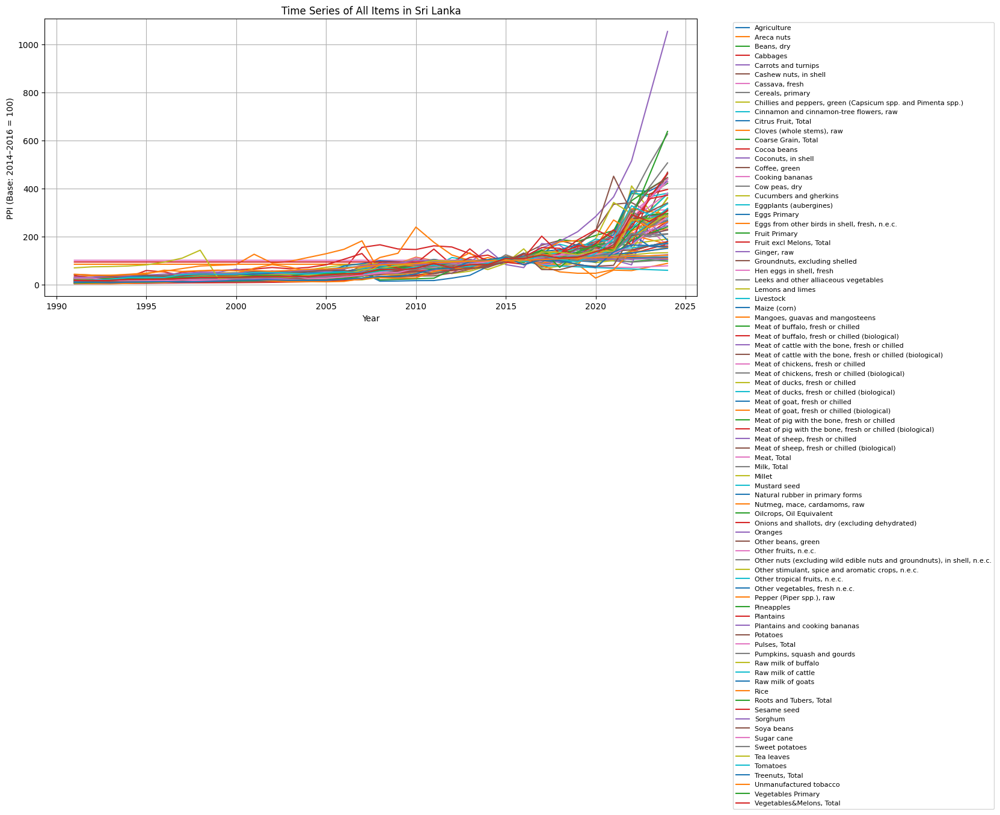

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


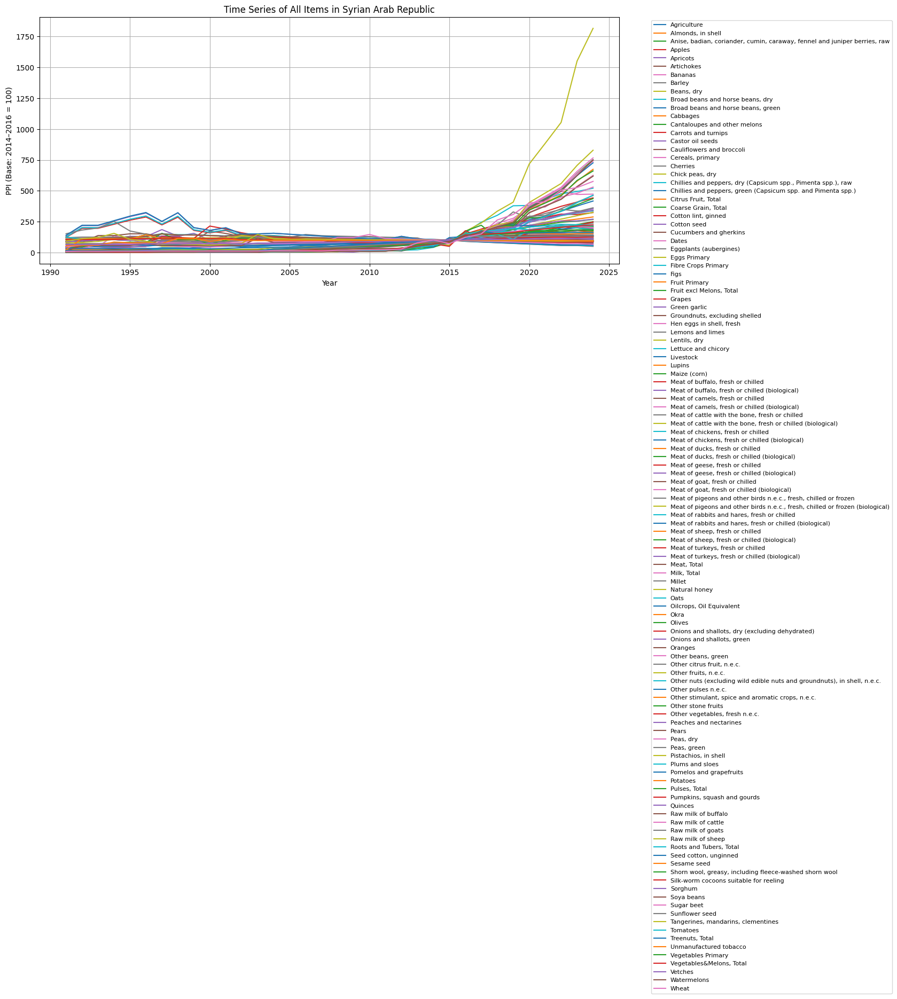

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


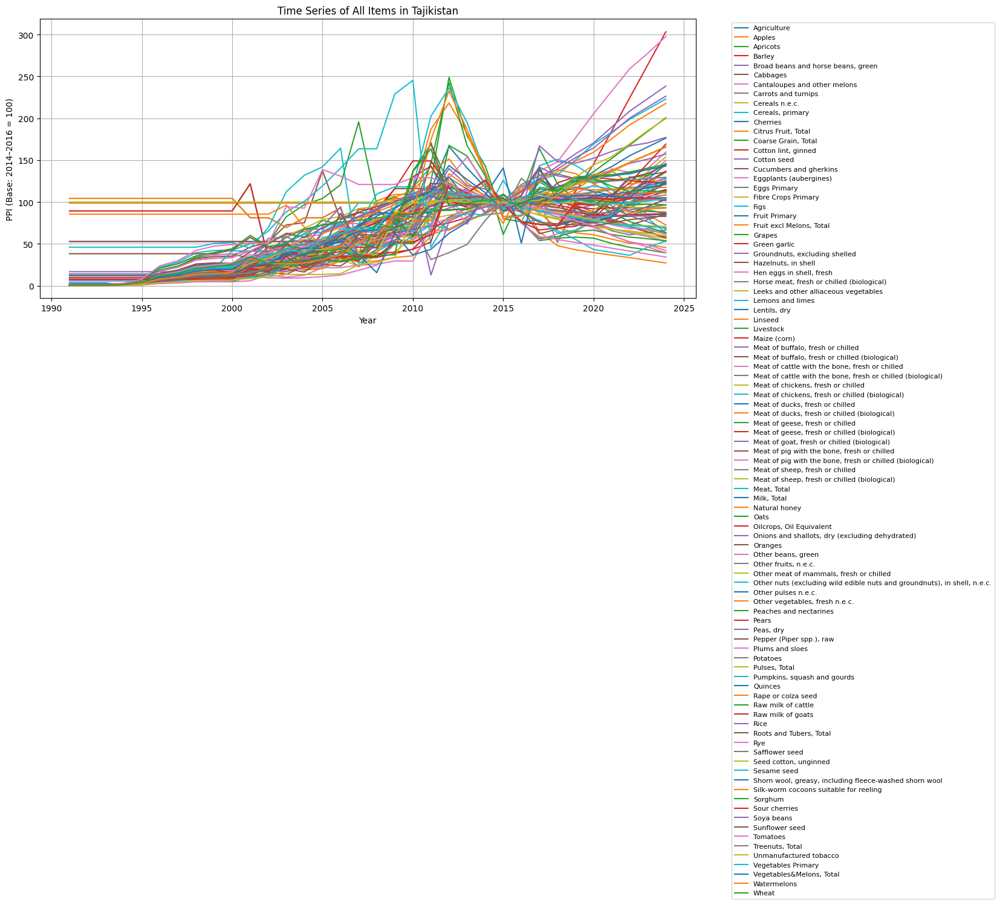

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


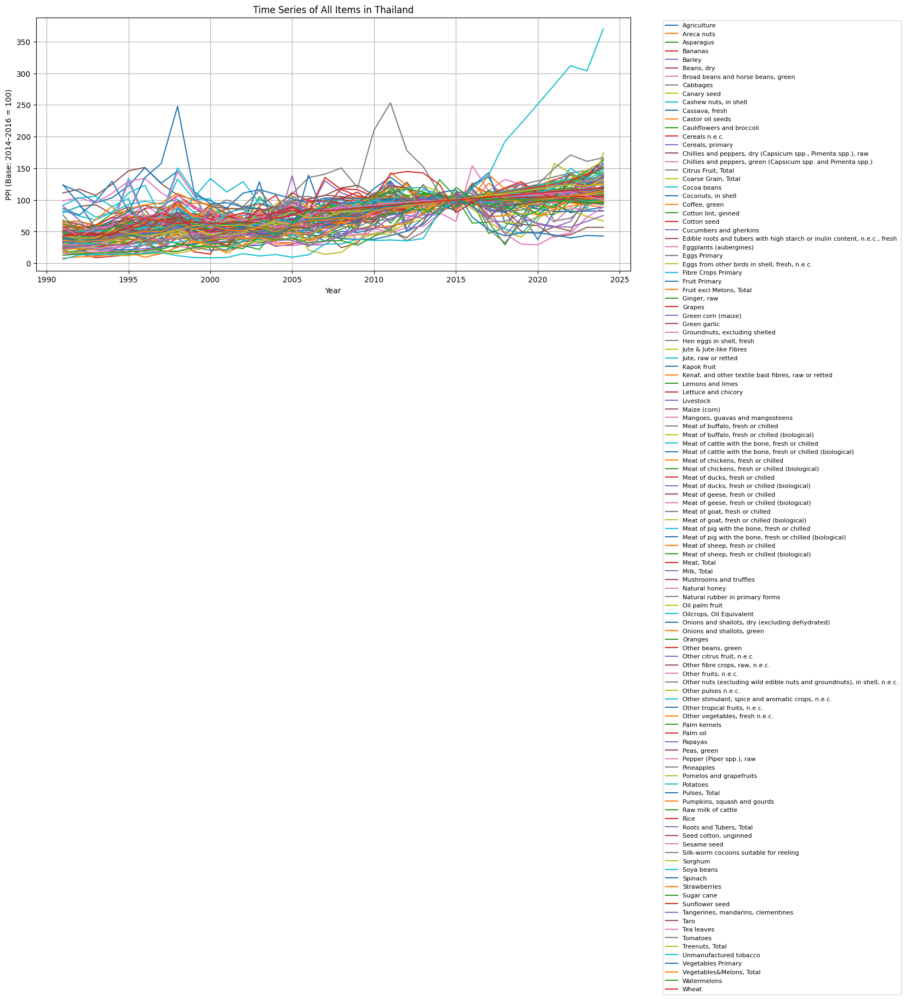

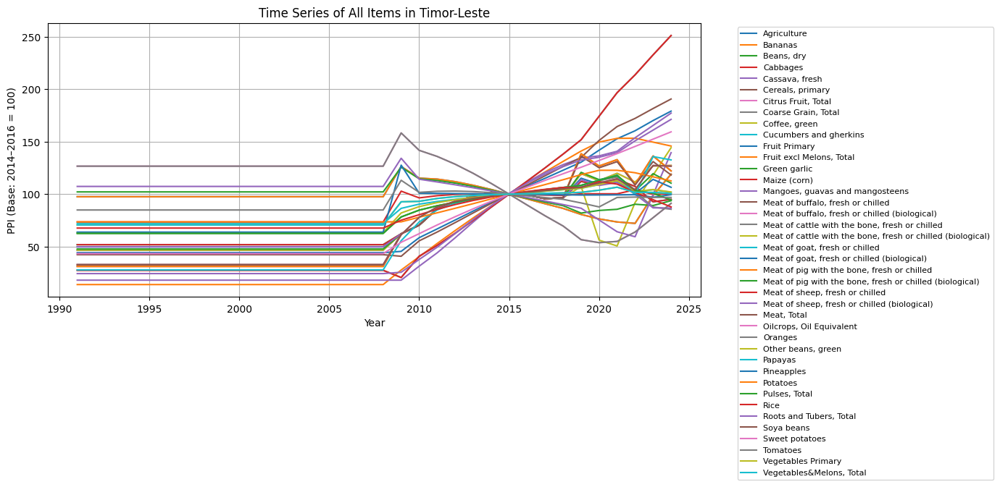

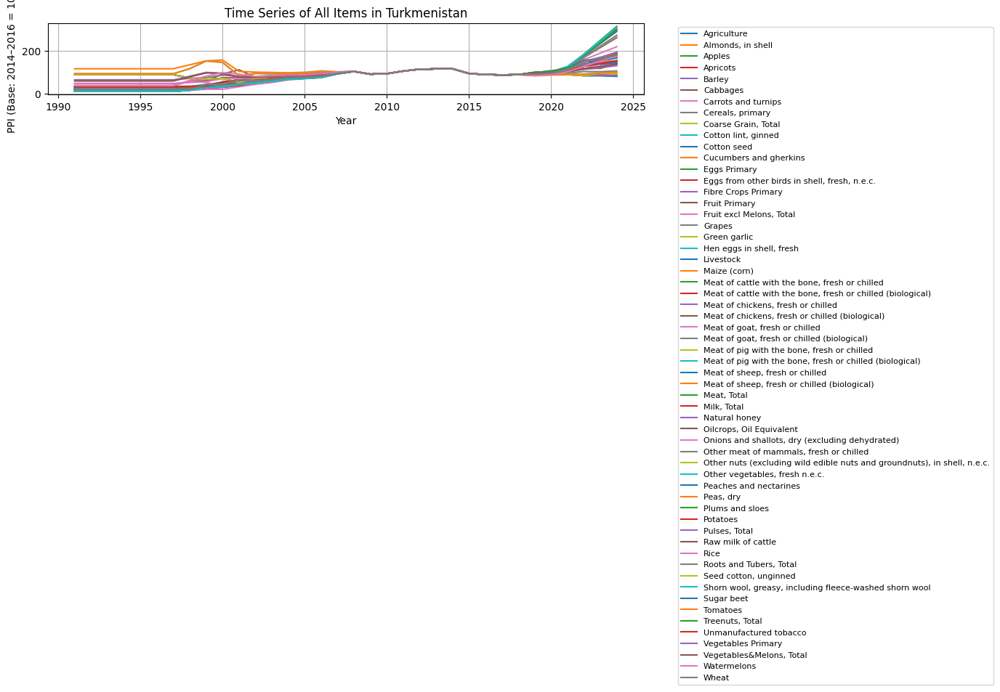

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


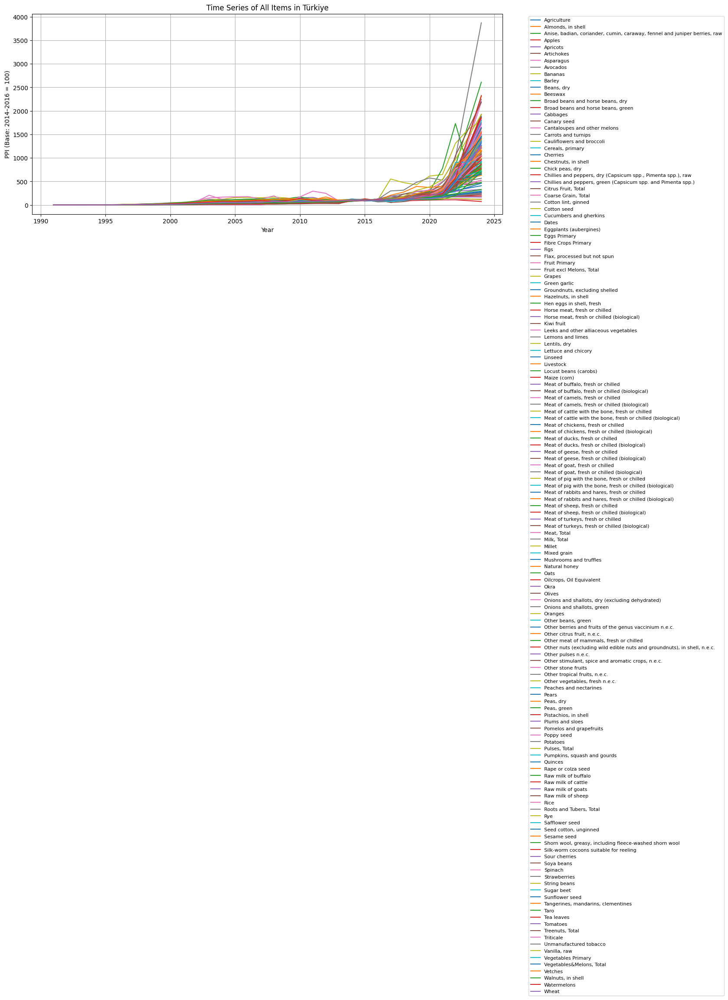

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


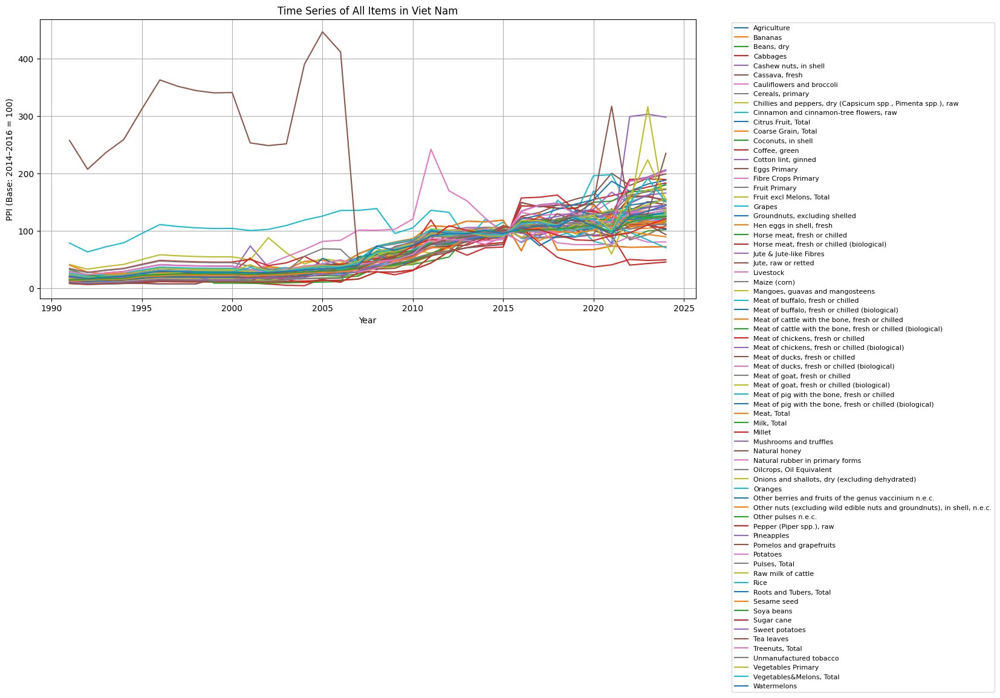

<ipython-input-16-419f73e27c5f>:19: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


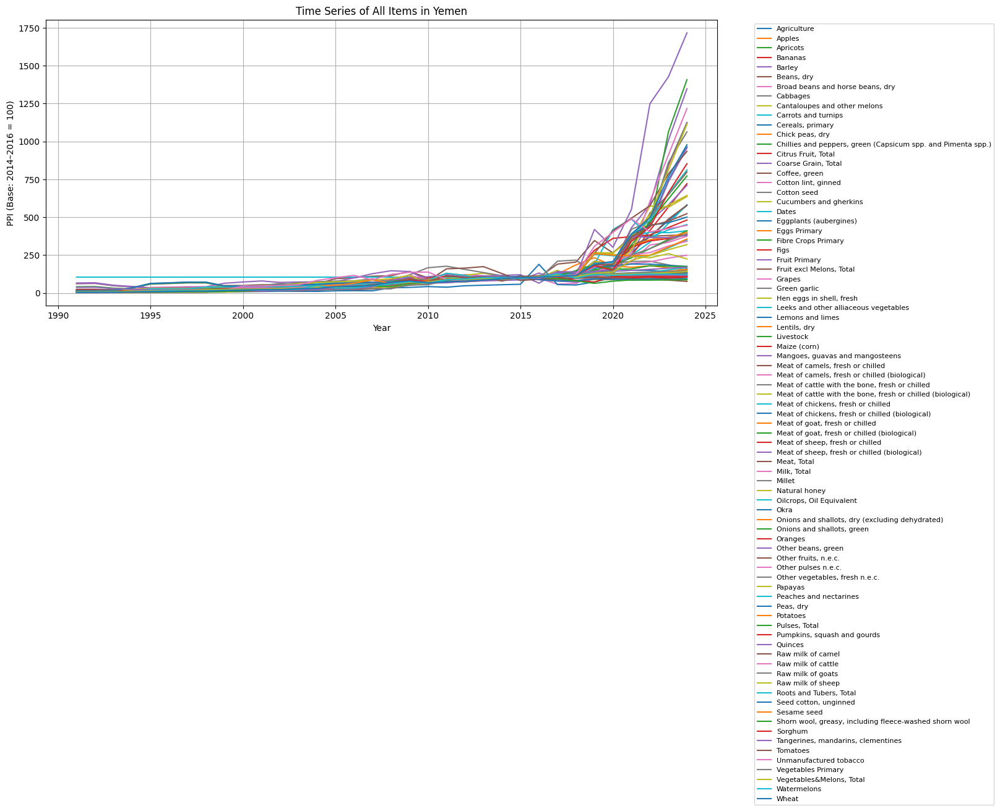

In [ ]:
import matplotlib.pyplot as plt

# Years for X-axis
years = [int(col[1:]) for col in year_cols]  # converts 'Y1991' → 1991


for area in df_grouped["Area"].unique():
    area_df = df_grouped[df_grouped["Area"] == area]

    plt.figure(figsize=(14, 6))
    for _, row in area_df.iterrows():
        plt.plot(years, row[year_cols], label=row["Item"])

    plt.title(f"Time Series of All Items in {area}")
    plt.xlabel("Year")
    plt.ylabel("PPI (Base: 2014–2016 = 100)")
    plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), fontsize=8, ncol=1)
    plt.grid(True)
    plt.tight_layout()
    plt.show()


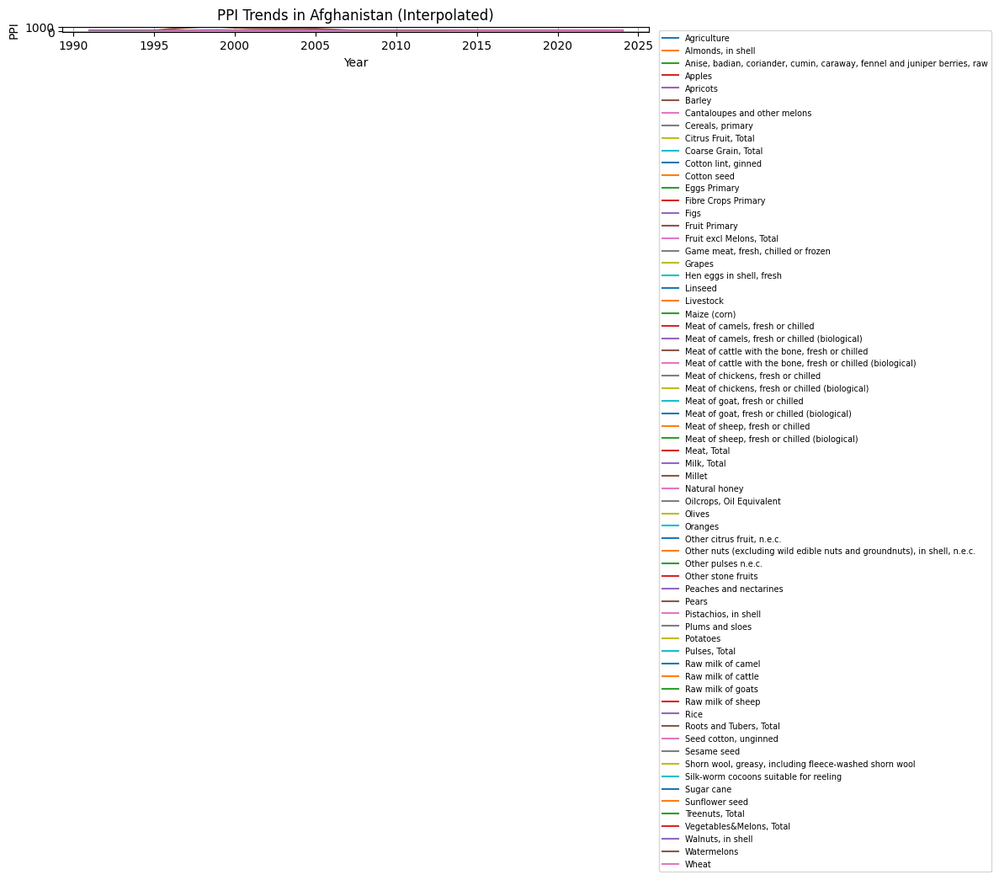

<ipython-input-14-e2e8ea3b0c96>:15: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


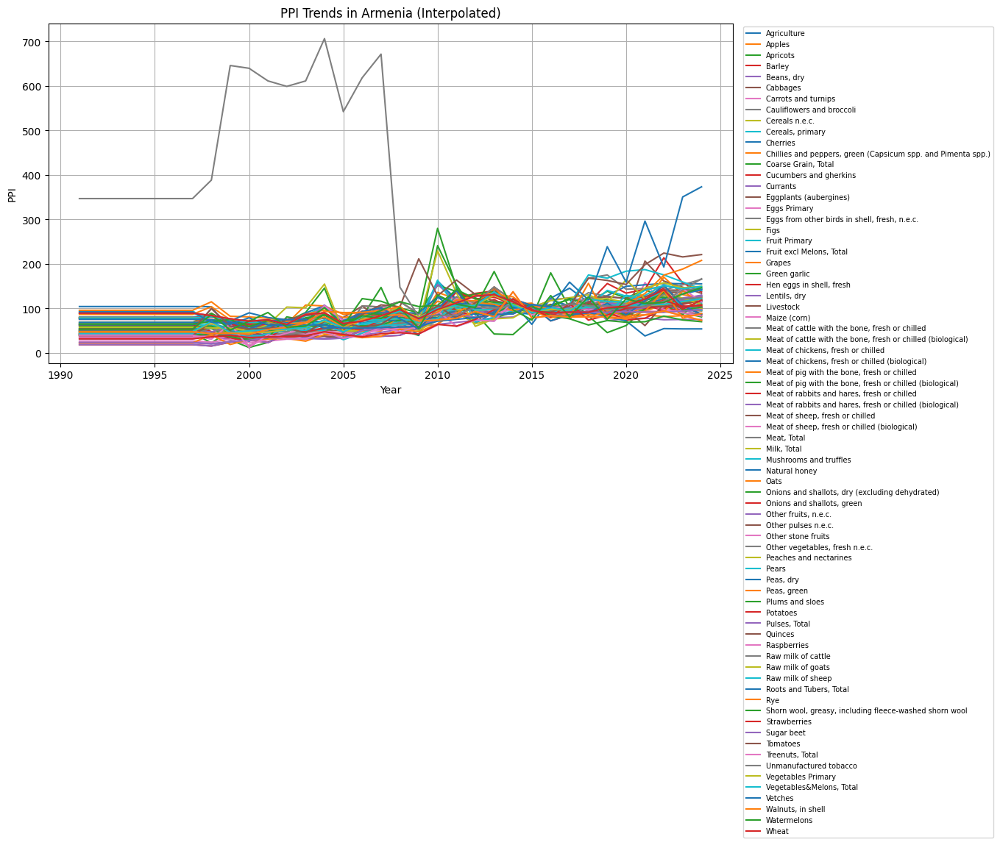

<ipython-input-14-e2e8ea3b0c96>:15: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


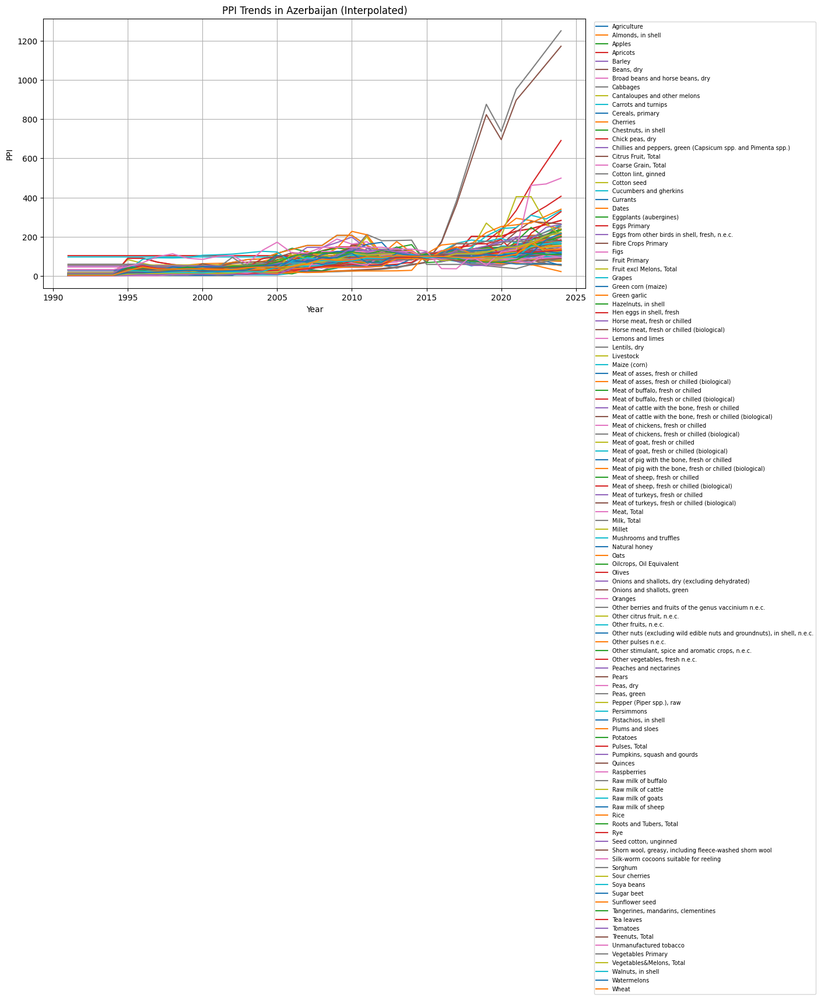

In [ ]:
areas = df_grouped["Area"].unique()

for area in areas[:3]:  # limit to first 3 areas to avoid too many plots
    area_df = df_grouped[df_grouped["Area"] == area]

    plt.figure(figsize=(12, 6))
    for _, row in area_df.iterrows():
        plt.plot(years, row[year_cols], label=row["Item"])

    plt.title(f"PPI Trends in {area} (Interpolated)")
    plt.xlabel("Year")
    plt.ylabel("PPI")
    plt.legend(fontsize=7, loc="upper left", bbox_to_anchor=(1.01, 1))
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [ ]:
df

,Area,Item,Element,Y1991,Y1992,Y1993,Y1994,Y1995,Y1996,Y1997,...,Y2015,Y2016,Y2017,Y2018,Y2019,Y2020,Y2021,Y2022,Y2023,Y2024
2,Afghanistan,"Almonds, in shell",Producer Price Index (2014-2016 = 100),21.57,21.57,21.57,23.44,29.07,23.44,19.22,...,101.22,93.36,89.57,85.02,85.74,86.56,86.76,87.06,87.39,87.72
3,Afghanistan,"Anise, badian, coriander, cumin, caraway, fenn...",Producer Price Index (2014-2016 = 100),10.62,10.62,10.62,10.62,19.72,26.69,33.37,...,101.22,93.36,89.57,85.02,79.84,73.46,67.33,61.08,56.49,51.09
6,Afghanistan,Apples,Producer Price Index (2014-2016 = 100),25.13,25.13,25.13,25.55,18.54,65.92,76.22,...,83.58,129.37,147.09,92.01,102.71,108.68,113.68,115.65,114.20,112.75
9,Afghanistan,Apricots,Producer Price Index (2014-2016 = 100),130.06,130.06,130.06,148.00,161.45,152.48,139.03,...,98.62,98.66,111.67,107.30,109.35,112.68,116.37,120.38,120.38,126.01
12,Afghanistan,Barley,Producer Price Index (2014-2016 = 100),183.58,183.58,183.58,180.66,189.41,550.74,786.77,...,101.22,93.36,89.57,85.02,81.26,78.89,76.50,74.38,72.46,70.54
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28417,Yemen,"Oilcrops, Oil Equivalent",Producer Price Index (2014-2016 = 100),4.10,4.10,4.14,11.34,18.04,18.54,19.07,...,100.12,103.58,108.43,110.60,255.35,245.16,241.94,245.55,297.41,349.29
28418,Yemen,"Pulses, Total",Producer Price Index (2014-2016 = 100),6.28,5.12,6.74,8.48,13.10,15.58,17.19,...,98.99,106.91,112.17,147.58,184.63,157.19,158.57,179.39,175.52,174.54
28419,Yemen,"Roots and Tubers, Total",Producer Price Index (2014-2016 = 100),4.66,4.73,6.99,12.52,26.54,26.54,26.54,...,99.95,106.28,111.60,111.59,194.39,201.42,388.12,479.80,654.58,810.50
28420,Yemen,Vegetables Primary,Producer Price Index (2014-2016 = 100),8.98,9.83,10.30,12.53,14.88,16.09,17.80,...,101.38,109.85,113.53,106.97,132.38,144.68,249.78,292.11,344.68,390.36


**RANDOM** **FOREST**

In [ ]:
df_long_sorted = df_long.sort_values(["Area", "Item", "Year"])

def create_lags(group, lags=5):
    for lag in range(1, lags+1):
        group[f"lag_{lag}"] = group["Value"].shift(lag)
    return group

df_features = df_long_sorted.groupby(["Area", "Item"]).apply(create_lags).dropna().reset_index(drop=True)


<ipython-input-18-c3c913dca84f>:10: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_features = df_long_sorted.groupby(["Area", "Item"]).apply(create_lags).dropna().reset_index(drop=True)


In [ ]:
from sklearn.preprocessing import LabelEncoder

le_area = LabelEncoder()
le_item = LabelEncoder()

df_features["Area_enc"] = le_area.fit_transform(df_features["Area"])
df_features["Item_enc"] = le_item.fit_transform(df_features["Item"])


In [ ]:
feature_cols = [f"lag_{i}" for i in range(1, 6)] + ["Area_enc", "Item_enc"]
target_col = "Value"

X = df_features[feature_cols]
y = df_features[target_col]


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

model_rf = RandomForestRegressor(n_estimators=100, random_state=42)
model_rf.fit(X_train, y_train)

y_pred = model_rf.predict(X_test)


mse_rf = mean_squared_error(y_test, y_pred)
rmse_rf = np.sqrt(mse_rf)
r2_rf = r2_score(y_test, y_pred)
mae_rf = mean_absolute_error(y_test, y_pred)

print("MAE:", mae_rf)
print("MSE:", mse_rf)
print("RMSE:", rmse_rf)
print("R2 Score:", r2_rf)

MAE: 16.13692171979222
MSE: 2316.6385103140256
RMSE: 48.13147110066371
R2 Score: 0.8858030839534963


In [ ]:
mape_rf = np.mean(np.abs((y_test - y_pred) / y_test)) * 100
accuracy_rf = 100 - mape_rf

print(f"MAPE: {mape_rf:.2f}%")
print(f"Approximate Accuracy: {accuracy_rf:.2f}%")

MAPE: 19.07%
Approximate Accuracy: 80.93%


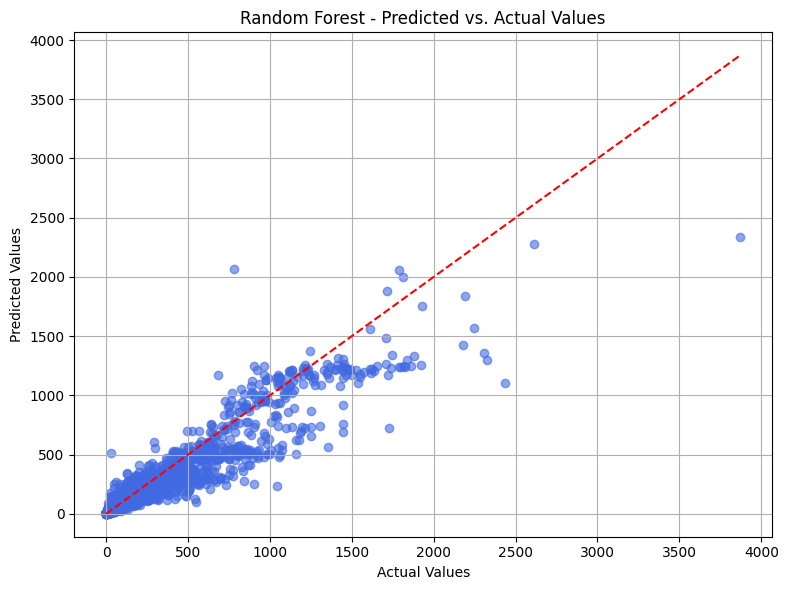

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='royalblue')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Random Forest - Predicted vs. Actual Values")
plt.grid(True)
plt.tight_layout()
plt.show()


**DECISION TREE**

In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import numpy as np

model_dt = DecisionTreeRegressor(random_state=42)
model_dt.fit(X_train, y_train)

y_pred = model_dt.predict(X_test)

mse_dt = mean_squared_error(y_test, y_pred)
rmse_dt = np.sqrt(mean_squared_error(y_test, y_pred))
r2_dt = r2_score(y_test, y_pred)
mae_dt = mean_absolute_error(y_test, y_pred)

print("MAE:", mae_dt)
print("MSE:", mse_dt)
print("RMSE:", rmse_dt)
print("R2 Score:", r2_dt)


MAE: 23.90246015295269
MSE: 4162.337638111931
RMSE: 64.5161812114754
R2 Score: 0.7948207630580055


In [ ]:
mape_rf = np.mean(np.abs((y_test - y_pred) / y_test)) * 100
accuracy_rf = 100 - mape_rf

print(f"MAPE: {mape_rf:.2f}%")
print(f"Approximate Accuracy: {accuracy_rf:.2f}%")

MAPE: 28.15%
Approximate Accuracy: 71.85%


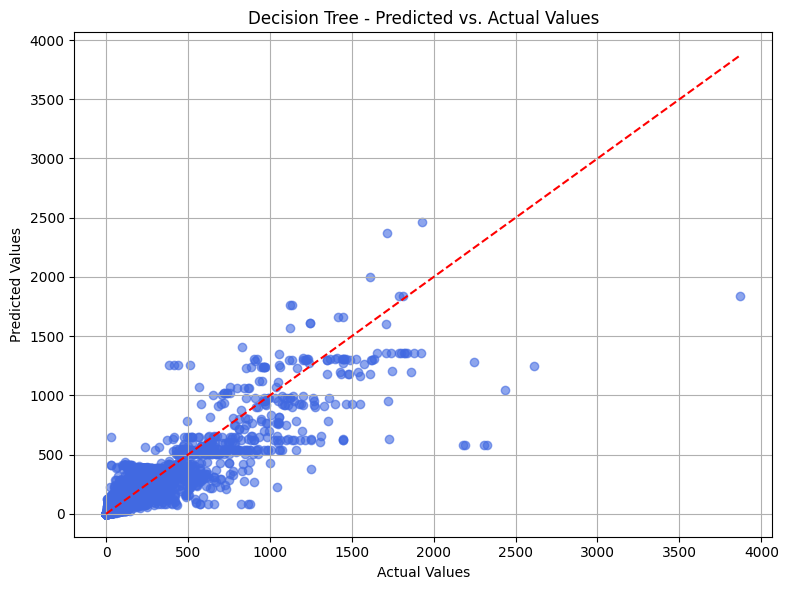

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='royalblue')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("Decision Tree - Predicted vs. Actual Values")
plt.grid(True)
plt.tight_layout()
plt.show()


**LINEAR** **REGRESSION**

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import numpy as np

model_lr = LinearRegression()
model_lr.fit(X_train, y_train)

y_pred = model_lr.predict(X_test)


mae_lr = mean_absolute_error(y_test, y_pred)
mse_lr = mean_squared_error(y_test, y_pred)
rmse_lr = np.sqrt(mean_squared_error(y_test, y_pred))
r2_lr = r2_score(y_test, y_pred)

print("MAE:", mae_lr)
print("MSE:", mse_lr)
print("RMSE:", rmse_lr)
print("R2 Score:", r2_lr)


MAE: 14.030874858714096
MSE: 2245.0229509745936
RMSE: 47.38167315507752
R2 Score: 0.8893333179460237


In [ ]:
mape_rf = np.mean(np.abs((y_test - y_pred) / y_test)) * 100
accuracy_rf = 100 - mape_rf

print(f"MAPE: {mape_rf:.2f}%")
print(f"Approximate Accuracy: {accuracy_rf:.2f}%")

MAPE: 13.44%
Approximate Accuracy: 86.56%


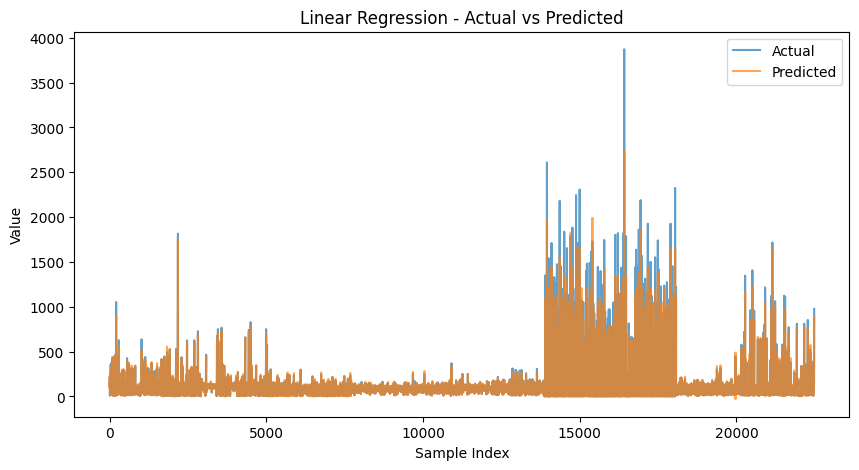

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
plt.plot(y_test.values, label="Actual", alpha=0.7)
plt.plot(y_pred, label="Predicted", alpha=0.7)
plt.title("Linear Regression - Actual vs Predicted")
plt.xlabel("Sample Index")
plt.ylabel("Value")
plt.legend()
plt.show()


**LIGHTGBM**

In [ ]:
import lightgbm as lgb
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

model_lgb = lgb.LGBMRegressor(objective='regression', metric='rmse', n_estimators=1000, learning_rate=0.05)
model_lgb.fit(X_train, y_train)

y_pred = model_lgb.predict(X_test)

mae_lgb = mean_absolute_error(y_test, y_pred)
mse_lgb = mean_squared_error(y_test, y_pred)
rmse_lgb = np.sqrt(mse_lgb)
r2_lgb = r2_score(y_test, y_pred)
mape_lgb = np.mean(np.abs((y_test - y_pred) / y_test)) * 100
accuracy_lgb = 100 - mape_lgb


print(f"Mean Absolute Error: {mae_lgb}")
print(f"Mean Squared Error: {mse_lgb}")
print(f"RMSE: {rmse_lgb}")
print(f"R-squared: {r2_lgb}")
print(f"MAPE: {mape_lgb:.2f}%")
print(f"Accuracy: {accuracy_lgb:.2f}%")

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002351 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1524
[LightGBM] [Info] Number of data points in the train set: 89923, number of used features: 7
[LightGBM] [Info] Start training from score 88.223608
Mean Absolute Error: 21.591102134608256
Mean Squared Error: 7479.201458631225
RMSE: 86.48237657830192
R-squared: 0.6313185085788708
MAPE: 21.27%
Accuracy: 78.73%


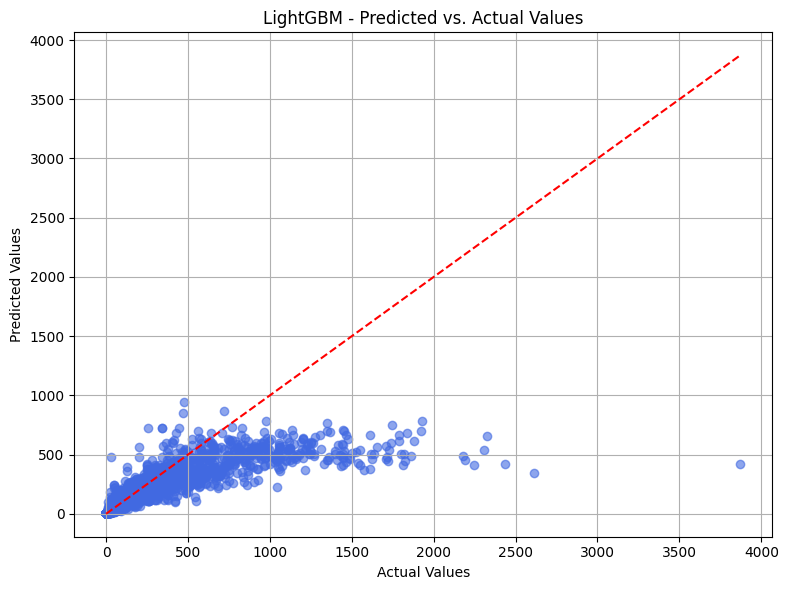

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.6, color='royalblue')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')  # perfect prediction line
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("LightGBM - Predicted vs. Actual Values")
plt.grid(True)
plt.tight_layout()
plt.show()


**XGBoost**

In [ ]:
from sklearn.preprocessing import LabelEncoder

for col in ["Area", "Item"]:
    le = LabelEncoder()
    df_grouped[col] = le.fit_transform(df_grouped[col])

X = df_grouped[["Area", "Item"] + [y for y in year_cols if y != "Y2025"]]
y = df_grouped["Y2024"]


**LSTM**

In [ ]:
import numpy as np
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df_scaled = df_grouped.copy()
df_scaled[year_cols] = scaler.fit_transform(df_grouped[year_cols])
sequence_length = 10
X_seq, y_seq = [], []

for i in range(len(df_scaled)):
    row = df_scaled.loc[i, year_cols].values
    for j in range(len(row) - sequence_length):
        X_seq.append(row[j:j+sequence_length])
        y_seq.append(row[j+sequence_length])

X_seq = np.array(X_seq)
y_seq = np.array(y_seq)

X_seq = X_seq.reshape((X_seq.shape[0], X_seq.shape[1], 1))


** Model Training for XGBoost**

In [ ]:
import numpy as np
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model_xgb = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=1000, learning_rate=0.01)
model_xgb.fit(X_train, y_train)
y_pred_xgb = model_xgb.predict(X_test)


mse_xgb = mean_squared_error(y_test, y_pred_xgb)
rmse_xgb = np.sqrt(mse_xgb)
mae_xgb = mean_absolute_error(y_test, y_pred_xgb)
r2_xgb = r2_score(y_test, y_pred_xgb)

print(f"MAE: {mae_xgb}")
print(f"MSE: {mse_xgb}")
print(f"RMSE: {rmse_xgb}")
print(f"R2 Score: {r2_xgb}")

MAE: 2.117119081438202
MSE: 72.45468181437295
RMSE: 8.51203159148114
R2 Score: 0.9990683466376719


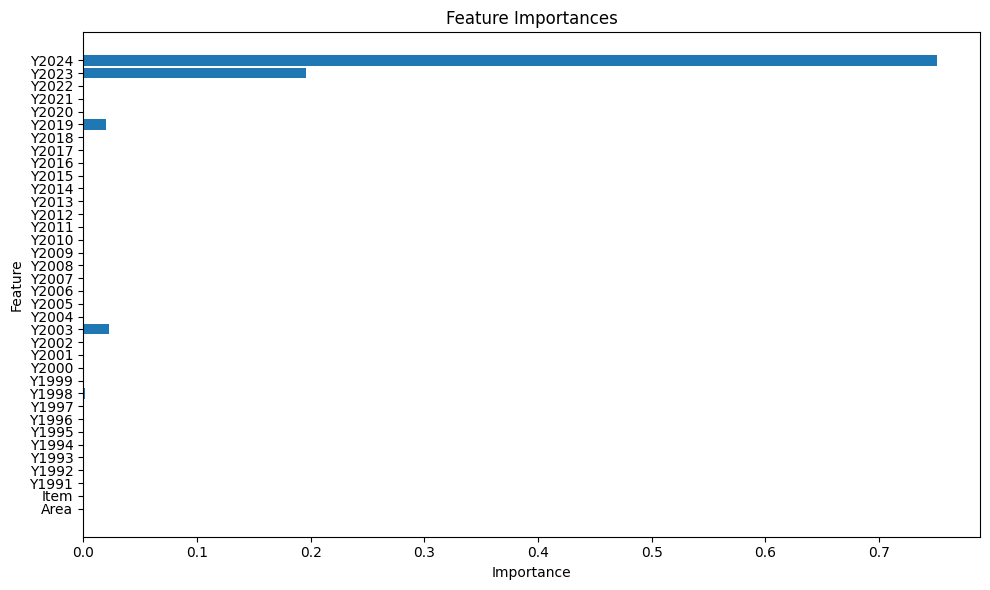

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
xgb_plot = model_xgb.feature_importances_
plt.barh(X.columns, xgb_plot)
plt.title("Feature Importances for XGBoost")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()


In [ ]:
pip install shap

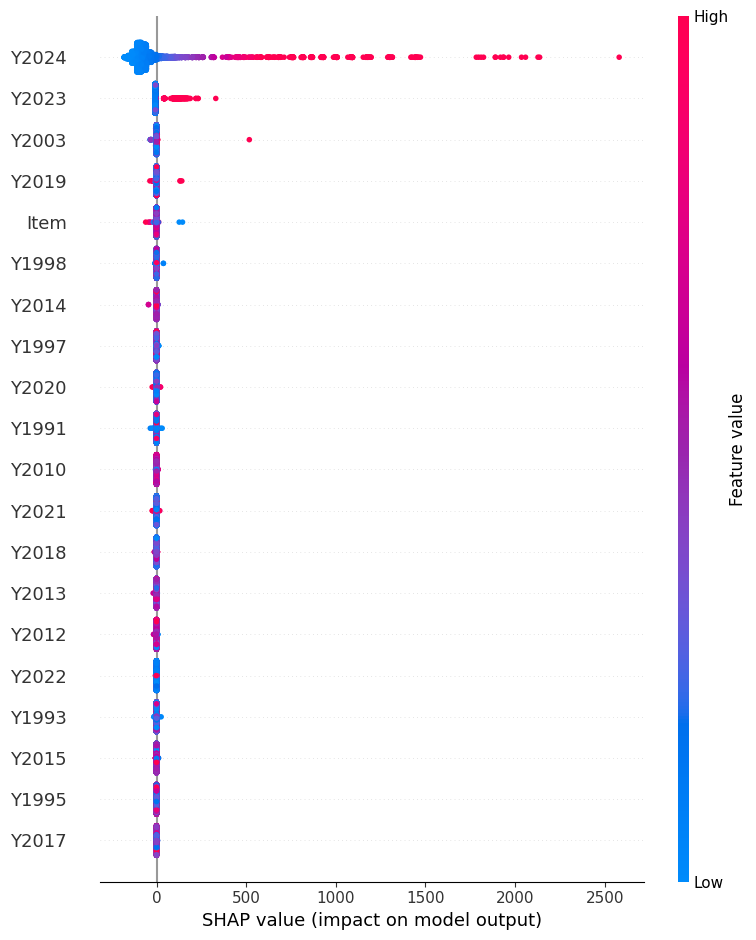

In [ ]:
import shap


explainer = shap.Explainer(model_xgb)


shap_values = explainer(X)
shap.summary_plot(shap_values, X)


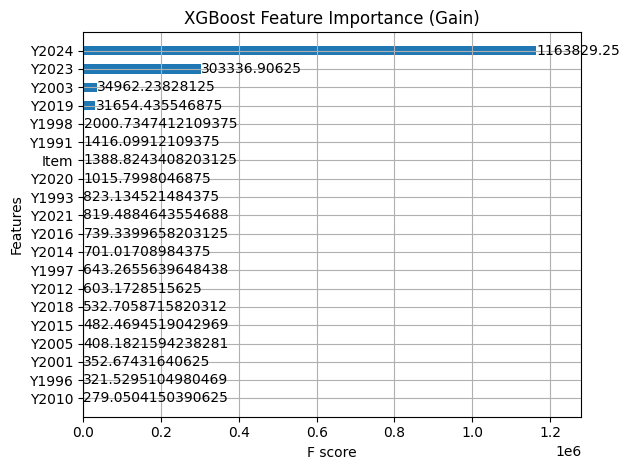

In [ ]:
import xgboost as xgb

xgb.plot_importance(model_xgb, importance_type='gain', max_num_features=20,
                    title="XGBoost Feature Importance (Gain)", height=0.5)
plt.tight_layout()
plt.show()


***Model Training for LSTM***

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, LSTM, Dense, Dropout
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split


scaler = MinMaxScaler()
df_scaled = df_grouped.copy()
df_scaled[year_cols] = scaler.fit_transform(df_scaled[year_cols].astype(float))

sequence_length = 10
X_seq, y_seq = [], []

for i in range(len(df_scaled)):
    row = df_scaled.loc[i, year_cols].values.astype(float)
    for j in range(len(row) - sequence_length):
        X_seq.append(row[j:j+sequence_length])
        y_seq.append(row[j+sequence_length])

X_seq = np.array(X_seq).astype(np.float32)
y_seq = np.array(y_seq).astype(np.float32)


X_seq = X_seq.reshape((X_seq.shape[0], X_seq.shape[1], 1))
X_train_lstm, X_test_lstm, y_train_lstm, y_test_lstm = train_test_split(
    X_seq, y_seq, test_size=0.2, random_state=42
)

model_lstm = Sequential([
    Input(shape=(X_train_lstm.shape[1], X_train_lstm.shape[2])),
    LSTM(64, return_sequences=False),
    Dropout(0.2),
    Dense(1)
])

model_lstm.compile(optimizer='adam', loss='mean_squared_error')
model_lstm.fit(X_train_lstm, y_train_lstm, epochs=20, batch_size=32,
               validation_data=(X_test_lstm, y_test_lstm))

y_pred_lstm = model_lstm.predict(X_test_lstm)


mae_lstm = mean_absolute_error(y_test_lstm, y_pred_lstm)
mse_lstm= mean_squared_error(y_test_lstm, y_pred_lstm)
rmse_lstm = np.sqrt(np.mean((y_test_lstm - y_pred_lstm) ** 2))
r2_lstm = r2_score(y_test_lstm, y_pred_lstm)

print(f"MAE: {mae_lstm}")
print(f"MSE {mse_lstm}")
print(f"LSTM RMSE: {rmse_lstm}")
print(f"R2 Score: {r2_lstm}")



Epoch 1/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 23s 9ms/step - loss: 0.0091 - val_loss: 0.0062
Epoch 2/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 40s 8ms/step - loss: 0.0057 - val_loss: 0.0043
Epoch 3/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 23s 9ms/step - loss: 0.0042 - val_loss: 0.0038
Epoch 4/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 40s 9ms/step - loss: 0.0038 - val_loss: 0.0036
Epoch 5/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 20s 8ms/step - loss: 0.0036 - val_loss: 0.0034
Epoch 6/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 21s 9ms/step - loss: 0.0032 - val_loss: 0.0030
Epoch 7/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 20s 9ms/step - loss: 0.0031 - val_loss: 0.0029
Epoch 8/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 19s 8ms/step - loss: 0.0028 - val_loss: 0.0028
Epoch 9/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 21s 9ms/step - loss: 0.0026 - val_loss: 0.0028
Epoch 10/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 19s 8ms/step - loss: 0.0028 - val_loss: 0.0027
Epoch 11/20
2326/2326 ━━━━━━━━━━━━━━━━━━━━ 21s 9ms/step - loss: 0.0026 - val_loss: 0.0026
Epoch 12/20
2326/23

**VISUALIZE PREDICTIONS **

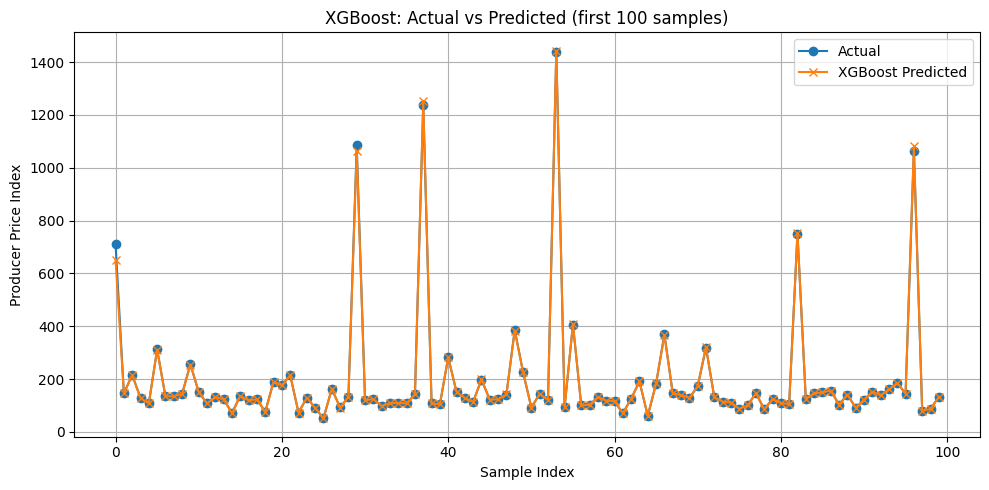

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
plt.plot(y_test.values[:100], label="Actual", marker='o')
plt.plot(y_pred_xgb[:100], label="XGBoost Predicted", marker='x')
plt.title("XGBoost: Actual vs Predicted (first 100 samples)")
plt.xlabel("Sample Index")
plt.ylabel("Producer Price Index")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


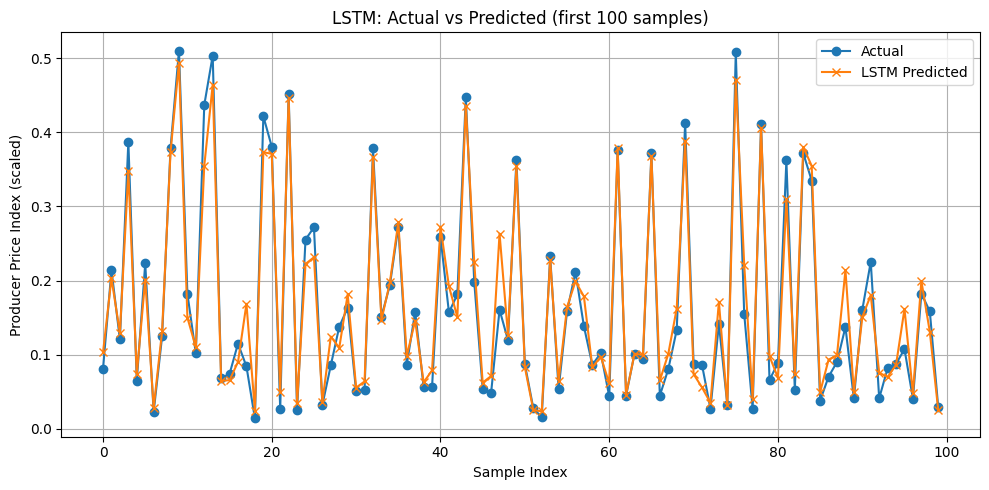

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(y_test_lstm[:100], label="Actual", marker='o')
plt.plot(y_pred_lstm[:100], label="LSTM Predicted", marker='x')
plt.title("LSTM: Actual vs Predicted (first 100 samples)")
plt.xlabel("Sample Index")
plt.ylabel("Producer Price Index (scaled)")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
comparison = pd.DataFrame({
    'Model': ['Random Forest', 'Decision Tree', 'Linear Regression', 'LightGBM','XGBoost', 'LSTM'],
    'MSE': [mse_rf, mse_dt,mse_lr, mse_lgb, mse_xgb, mse_lstm],
    'RMSE': [rmse_rf, rmse_dt, rmse_lr, rmse_lgb, rmse_xgb, rmse_lstm],
    'MAE': [mae_rf, mae_dt, mae_lr, mae_lgb, mae_xgb, mae_lstm],
    'R2 Score': [r2_rf, r2_dt, r2_lr, r2_lgb, r2_xgb, r2_lstm]
})

print(comparison)


               Model          MSE       RMSE        MAE  R2 Score
0      Random Forest  2316.638510  48.131471  16.136922  0.885803
1      Decision Tree  4162.337638  64.516181  23.902460  0.794821
2  Linear Regression  2245.022951  47.381673  14.030875  0.889333
3           LightGBM  7479.201459  86.482377  21.591102  0.631319
4            XGBoost    72.454682   8.512032   2.117119  0.999068
5               LSTM     0.002147   0.168750   0.025834  0.862683


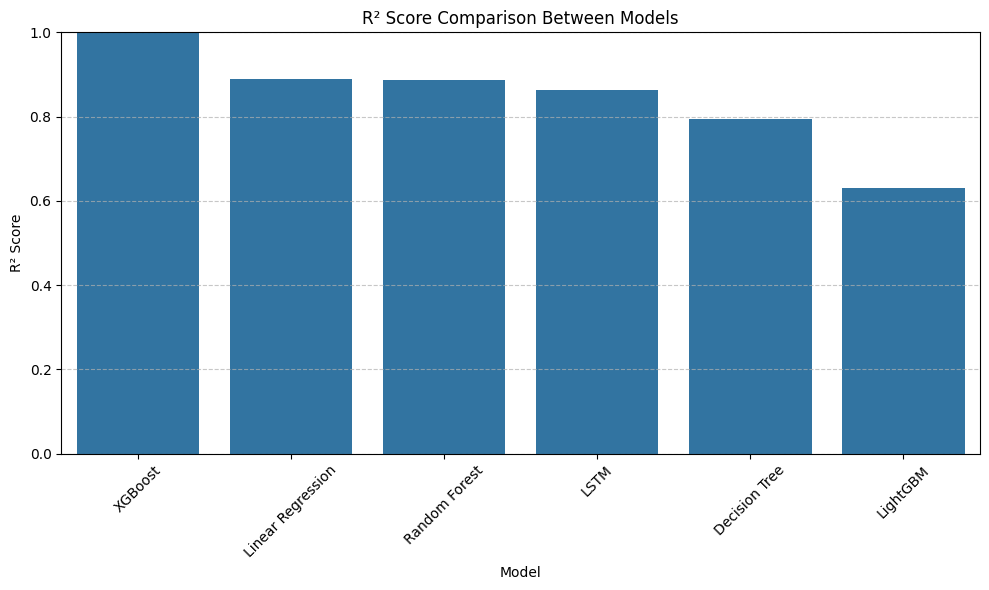

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

comparison = pd.DataFrame({
    'Model': ['Random Forest', 'Decision Tree', 'Linear Regression', 'LightGBM', 'XGBoost', 'LSTM'],
    'R2 Score': [r2_rf, r2_dt, r2_lr, r2_lgb, r2_xgb, r2_lstm]
})

plt.figure(figsize=(10, 6))
sns.barplot(x='Model', y='R2 Score', data=comparison.sort_values("R2 Score", ascending=False))
plt.title('R² Score Comparison Between Models')
plt.ylabel('R² Score')
plt.ylim(0, 1)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


**XGBoost: Predict Y2025**

In [ ]:
X_full = df_grouped[["Area", "Item"] + [y for y in year_cols if y != "Y2025"]]
pred_2025_xgb = model_xgb.predict(X_full)
df_grouped["Predicted_Y2025_XGB"] = pred_2025_xgb


**LSTM: Predict 2025**

In [ ]:
last_10_years = year_cols[-10:]
X_seq_2025 = df_scaled[last_10_years].values.astype(np.float32).reshape(-1, 10, 1)

pred_2025_lstm_scaled = model_lstm.predict(X_seq_2025)
pred_2025_lstm = scaler.inverse_transform(
    np.hstack([np.zeros((pred_2025_lstm_scaled.shape[0], len(year_cols)-1)), pred_2025_lstm_scaled])
)[:, -1]

df_grouped["Predicted_Y2025_LSTM"] = pred_2025_lstm


122/122 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step


In [ ]:
df_grouped[["Area", "Item", "Predicted_Y2025_XGB", "Predicted_Y2025_LSTM"]].head()


,Area,Item,Predicted_Y2025_XGB,Predicted_Y2025_LSTM
0,0,2,110.598190,116.613476
1,0,3,87.933266,105.754819
2,0,4,51.475285,71.237501
3,0,5,112.593323,120.274230
4,0,6,125.904366,136.572497
